# Batch Analysis of Attention and Attribution

## Objective
This notebook analyzes how attention and feature attributions for a single protein sequence change when paired with different SMILES compounds.

### Questions to Answer:
1.  **Attention Behavior**: How does the attention mechanism behave on a single sequence for its tested SMILES? Are there consistent "hotspots"?
2.  **Attribution Behavior**: How do the protein's latent-embedding attributions behave? Is the feature importance profile stable or drug-dependent?


## 1. Setup and Imports

In [1]:
import sys, os
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))

In [2]:
import numpy as np
import torch
import pandas as pd
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

from collections import Counter
import pandas as pd
from MGraphDTA.visualization.visualization_mgnn import clourMol
import base64
import gc
from io import BytesIO
from matplotlib.colors import ListedColormap

from torch_geometric.explain import Explainer as PyGExplainer
from torch_geometric.explain.algorithm import GNNExplainer as PyGGNNExplainer
from torch_geometric.explain.config import ModelConfig, ExplanationType
from torch_geometric.data import Data
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D

from MGraphDTA.regression.preprocessing import GNNDataset
from xai_dta.utils.models import load_model
from xai_dta.config import PROJ_ROOT
from xai.explainer import Explainer
from xai.interaction_explainer import InteractionExplainer
from xai.visualization.sequence_visual import plot_sequence_attention
from src.utils.plot_utils import set_plot_style, get_styled_figure_ax, style_legend, adjust_plot_limits
DATASET_COLORS = ['#95BB63', '#BCBCE0', '#77b5b6', '#EA805D']

2025-11-28 12:24:13.902 | INFO     | xai_dta.config:<module>:17 - PROJ_ROOT path is: /home/alex/dev/projects/dl_imt4392/dl_project


In [3]:
import importlib
import xai.explainer
importlib.reload(xai.explainer)
from xai.explainer import Explainer

In [3]:
# Matplotlib and plotting setup
# get_ipython().run_line_magic('matplotlib', 'inline')
# get_ipython().run_line_magic('config', "InlineBackend.figure_format = 'svg'")
set_plot_style()
sns.set_context("notebook")
get_ipython().run_line_magic('config', "InlineBackend.figure_format = 'svg'")

In [4]:
# Constants
OUTPUT_DIR = "results/batch_attention_analysis"
os.makedirs(OUTPUT_DIR, exist_ok=True)

## 2. Load Model and Data

In [5]:
device = 'cpu'
print(f"Using device: {device}")

Using device: cpu


In [6]:
# Load model
model = load_model(
    PROJ_ROOT, 
    model_name="kiba/epoch-2578, loss-0.0122, cindex-0.9741, test_loss-0.1265.pt"
)
model.to(device)
model.eval()

MGraphDTA(
  (protein_encoder): TargetRepresentation(
    (embed): Embedding(26, 128, padding_idx=0)
    (block_list): ModuleList(
      (0): StackCNN(
        (inc): Sequential(
          (conv_layer0): Conv1dReLU(
            (inc): Sequential(
              (0): Conv1d(128, 96, kernel_size=(3,), stride=(1,))
              (1): ReLU()
            )
          )
          (pool_layer): AdaptiveMaxPool1d(output_size=1)
        )
      )
      (1): StackCNN(
        (inc): Sequential(
          (conv_layer0): Conv1dReLU(
            (inc): Sequential(
              (0): Conv1d(128, 96, kernel_size=(3,), stride=(1,))
              (1): ReLU()
            )
          )
          (conv_layer1): Conv1dReLU(
            (inc): Sequential(
              (0): Conv1d(96, 96, kernel_size=(3,), stride=(1,))
              (1): ReLU()
            )
          )
          (pool_layer): AdaptiveMaxPool1d(output_size=1)
        )
      )
      (2): StackCNN(
        (inc): Sequential(
          (conv_la

In [7]:
# Load dataset
dataset_name = 'kiba'
dataset_path = os.path.join(PROJ_ROOT, "MGraphDTA", "regression", "data", dataset_name)
data_df = pd.read_csv(os.path.join(dataset_path, 'raw', f"data_test.csv"))
dataset = GNNDataset(root=dataset_path, train=False, transform_unique=True)

2025-11-28 12:24:15.610 | INFO     | MGraphDTA.regression.preprocessing:load_graph_dict:317 - Loading graph dict from /home/alex/dev/projects/dl_imt4392/dl_project/MGraphDTA/regression/data/kiba/processed/graph_dict.pt
2025-11-28 12:24:16.193 | INFO     | MGraphDTA.regression.preprocessing:__init__:71 - Graph dict with 2068 entries loaded.


In [8]:
print("Model and dataset loaded successfully.")

Model and dataset loaded successfully.


## 3. Group Data by Protein and Select Top Proteins

We group the test set by protein sequence to easily access all drugs tested against each one. We then select the top 5 proteins with the most interactions for our analysis.

In [9]:
protein_groups = data_df.groupby('target_sequence')
protein_counts = protein_groups.size().sort_values(ascending=False)

In [10]:
# Select top 5 proteins for analysis
N_TOP_PROTEINS = 5
selected_proteins = protein_counts.head(N_TOP_PROTEINS).index.tolist()

In [11]:
print(f"Found {len(protein_groups)} unique protein sequences.")
print(f"Selected top {N_TOP_PROTEINS} proteins for analysis with counts:\n{protein_counts.head(N_TOP_PROTEINS)}")

Found 229 unique protein sequences.
Selected top 5 proteins for analysis with counts:
target_sequence
MQSKVLLAVALWLCVETRAASVGLPSVSLDLPRLSIQKDILTIKANTTLQITCRGQRDLDWLWPNNQSGSEQRVEVTECSDGLFCKTLTIPKVIGNDTGAYKCFYRETDLASVIYVYVQDYRSPFIASVSDQHGVVYITENKNKTVVIPCLGSISNLNVSLCARYPEKRFVPDGNRISWDSKKGFTIPSYMISYAGMVFCEAKINDESYQSIMYIVVVVGYRIYDVVLSPSHGIELSVGEKLVLNCTARTELNVGIDFNWEYPSSKHQHKKLVNRDLKTQSGSEMKKFLSTLTIDGVTRSDQGLYTCAASSGLMTKKNSTFVRVHEKPFVAFGSGMESLVEATVGERVRIPAKYLGYPPPEIKWYKNGIPLESNHTIKAGHVLTIMEVSERDTGNYTVILTNPISKEKQSHVVSLVVYVPPQIGEKSLISPVDSYQYGTTQTLTCTVYAIPPPHHIHWYWQLEEECANEPSQAVSVTNPYPCEEWRSVEDFQGGNKIEVNKNQFALIEGKNKTVSTLVIQAANVSALYKCEAVNKVGRGERVISFHVTRGPEITLQPDMQPTEQESVSLWCTADRSTFENLTWYKLGPQPLPIHVGELPTPVCKNLDTLWKLNATMFSNSTNDILIMELKNASLQDQGDYVCLAQDRKTKKRHCVVRQLTVLERVAPTITGNLENQTTSIGESIEVSCTASGNPPPQIMWFKDNETLVEDSGIVLKDGNRNLTIRRVRKEDEGLYTCQACSVLGCAKVEAFFIIEGAQEKTNLEIIILVGTAVIAMFFWLLLVIILRTVKRANGGELKTGYLSIVMDPDELPLDEHCERLPYDASKWEFPRDRLKLGKPLGRGAFGQVIEADAFGIDKTATCRTVAVKMLKEGATHSEHRALMSELKILIHIGHHLNV

## 4. Core Analysis: Compute Attention and Attributions

Now we loop through our selected proteins. For each protein, we iterate through all its associated SMILES from the test set and compute:
1.  **Attention Map**: The mean Grad-CAM across all convolutional layers.
2.  **Latent Attribution**: The 96-dimensional feature attribution vector for the protein embedding.

In [12]:
explainer = Explainer(model, device=device, dataset_name='kiba', path_prefix='..')
interaction_explainer = InteractionExplainer(model, device=device)

2025-11-28 12:24:18.246 | INFO     | MGraphDTA.regression.preprocessing:__init__:63 - Inference mode: graph_dict initialized empty (on-the-fly generation).
2025-11-28 12:24:18.247 | INFO     | xai.explainer:__init__:94 - Loaded dataset from ../MGraphDTA/regression/data/kiba


Preparing background sequences for LIME: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 9434.05it/s]


In [14]:
results = {}

In [15]:

for i, protein_seq in enumerate(selected_proteins):
    protein_name = f"Protein_{i+1}"
    print(f"\nAnalyzing {protein_name}: {protein_seq[:40]}... ({len(protein_groups.get_group(protein_seq))} SMILES)")
    
    smiles_list = protein_groups.get_group(protein_seq)['compound_iso_smiles'].tolist()
    
    protein_results = {
        'smiles': [],
        'predictions': [],
        'cams': [],
        'attributions': []
    }

    for smiles in tqdm(smiles_list, desc=f"Processing {protein_name}"):
        try:
            # 1. Get attention (Grad-CAM) by passing SMILES and protein sequence
            output_dict = explainer.explain(smiles_input=smiles, protein_input=protein_seq)
            
            # The data object is prepared inside explain() and returned
            data_obj = output_dict['data_obj']
            
            # 2. Get latent attributions using the data object from the explain call
            feature_result = interaction_explainer.gradient_interaction_map(data_obj)

            # Store results (mean CAM across all layers)
            # The output is a list of numpy arrays, so we can calculate the mean
            mean_cam = np.mean(output_dict['per_layer_cams'], axis=0)
            
            protein_results['smiles'].append(smiles)
            protein_results['predictions'].append(output_dict['prediction'])
            protein_results['cams'].append(mean_cam)
            protein_results['attributions'].append(feature_result['protein_attributions'])

        except Exception as e:
            import traceback
            print(f"\nCould not process SMILES: {smiles[:30]}...")
            print(f"Error: {e}")
    
    results[protein_name] = {
        'sequence': protein_seq,
        'data': protein_results
    }



Analyzing Protein_1: MQSKVLLAVALWLCVETRAASVGLPSVSLDLPRLSIQKDI... (239 SMILES)


Processing Protein_1:   0%|          | 0/239 [00:00<?, ?it/s]


Analyzing Protein_2: MGNAAAAKKGSEQESVKEFLAKAKEDFLKKWESPAQNTAH... (223 SMILES)


Processing Protein_2:   0%|          | 0/223 [00:00<?, ?it/s]

/home/alex/dev/projects/dl_imt4392/dl_project/MGraphDTA/regression/preprocessing.py:166: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:253.)
  target=torch.LongTensor([target]),



Analyzing Protein_3: MSANNSPPSAQKSVLPTAIPAVLPAASPCSSPKTGLSARL... (218 SMILES)


Processing Protein_3:   0%|          | 0/218 [00:00<?, ?it/s]


Analyzing Protein_4: MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTV... (210 SMILES)


Processing Protein_4:   0%|          | 0/210 [00:00<?, ?it/s]


Analyzing Protein_5: MGSNKSKPKDASQRRRSLEPAENVHGAGGGAFPASQTPSK... (202 SMILES)


Processing Protein_5:   0%|          | 0/202 [00:00<?, ?it/s]

In [16]:
print(len(results))

5


In [17]:
print("\nSaving analysis results to disk...")
results_filepath = os.path.join(OUTPUT_DIR, "analysis_results_2578.pt")
torch.save(results, results_filepath)
print(f"Analysis results saved to: {results_filepath}")

print("\nCore analysis complete. All attention maps and attributions have been computed.")


Saving analysis results to disk...
Analysis results saved to: results/batch_attention_analysis/analysis_results_2578.pt

Core analysis complete. All attention maps and attributions have been computed.


In [13]:
results_filepath = os.path.join(OUTPUT_DIR, "analysis_results_2578.pt")
results = torch.load(results_filepath, weights_only=False)

## 5. Visualization and Interpretation

Now we visualize the results for each protein.


--- Visualizing Results for Protein_1 ---


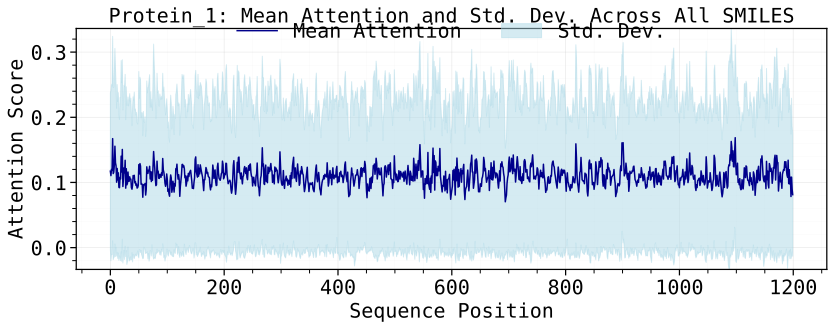

/home/alex/partition_hundred/.poetry_cache/virtualenvs/xai-dta-5F5YrYo2-py3.12/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/alex/partition_hundred/.poetry_cache/virtualenvs/xai-dta-5F5YrYo2-py3.12/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


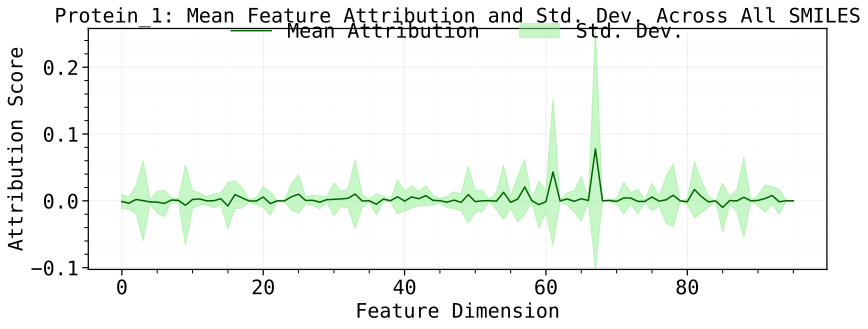

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


KeyboardInterrupt: 

In [20]:
for protein_name, result_data in results.items():
    print(f"\n--- Visualizing Results for {protein_name} ---")
    
    seq = result_data['sequence']
    data = result_data['data']
    
    cams = np.array(data['cams'])
    attributions = np.array(data['attributions'])
    
    # Create a dedicated output directory for this protein
    protein_output_dir = os.path.join(OUTPUT_DIR, protein_name)
    os.makedirs(protein_output_dir, exist_ok=True)
    
    # --- Attention (CAM) Analysis ---
    
    # 1. Mean and Std Dev of Attention
    mean_cam = np.mean(cams, axis=0)
    std_cam = np.std(cams, axis=0)
    
    fig, ax = get_styled_figure_ax(figsize=(12, 5), aspect='none', grid=True)
    ax.plot(mean_cam, label='Mean Attention', color='darkblue')
    ax.fill_between(range(len(mean_cam)), mean_cam - std_cam, mean_cam + std_cam, color='lightblue', alpha=0.5, label='Std. Dev.')
    ax.set_title(f'{protein_name}: Mean Attention and Std. Dev. Across All SMILES')
    ax.set_xlabel('Sequence Position')
    ax.set_ylabel('Attention Score')
    style_legend(ax)
    ax.set_ylim((mean_cam - std_cam).min(), (mean_cam + std_cam).max())
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "mean_attention_std_dev.svg"))
    plt.show()

    # 2. Attention Correlation Matrix
    cam_corr_matrix = np.corrcoef(cams.reshape(cams.shape[0], -1))
    
    fig, ax = get_styled_figure_ax(figsize=(8, 7))
    sns.heatmap(cam_corr_matrix, cmap='viridis', ax=ax)
    ax.set_title(f'{protein_name}: Attention Map Correlation Across SMILES')
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "attention_correlation_heatmap.svg"))
    plt.show()

    # --- Latent Attribution Analysis ---
    
    # 3. Mean and Std Dev of Attributions
    mean_attr = np.mean(attributions, axis=0)
    std_attr = np.std(attributions, axis=0)
    
    fig, ax = get_styled_figure_ax(figsize=(12, 5), aspect='none', grid=True)
    ax.plot(mean_attr, label='Mean Attribution', color='darkgreen')
    ax.fill_between(range(len(mean_attr)), mean_attr - std_attr, mean_attr + std_attr, color='lightgreen', alpha=0.5, label='Std. Dev.')
    ax.set_title(f'{protein_name}: Mean Feature Attribution and Std. Dev. Across All SMILES')
    ax.set_xlabel('Feature Dimension')
    ax.set_ylabel('Attribution Score')
    style_legend(ax)
    ax.set_ylim((mean_attr - std_attr).min(), (mean_attr + std_attr).max())
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "mean_attribution_std_dev.svg"))
    plt.show()

    # 4. Attribution Correlation Matrix
    attr_corr_matrix = np.corrcoef(attributions)
    
    fig, ax = get_styled_figure_ax(figsize=(8, 7))
    sns.heatmap(attr_corr_matrix, cmap='plasma', ax=ax)
    ax.set_title(f'{protein_name}: Attribution Vector Correlation Across SMILES')
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "attribution_correlation_heatmap.svg"))
    plt.show()

## 6. High vs. Low Binding Comparison

For each protein, we identify the drug with the highest and lowest predicted binding affinity and compare their protein feature attributions directly. This helps us understand if the model relies on different protein features when predicting strong vs. weak interactions.



--- Comparison for Protein_1 ---
Highest-binding drug: COc1cc(O)c2c(=O)oc3c(O)c(O)cc(C)c3c2c1 (Prediction: 15.0869)
Lowest-binding drug:  Oc1ccc2oc3ncc(O)c(-c4ccccc4)c3c2c1 (Prediction: 9.4151)


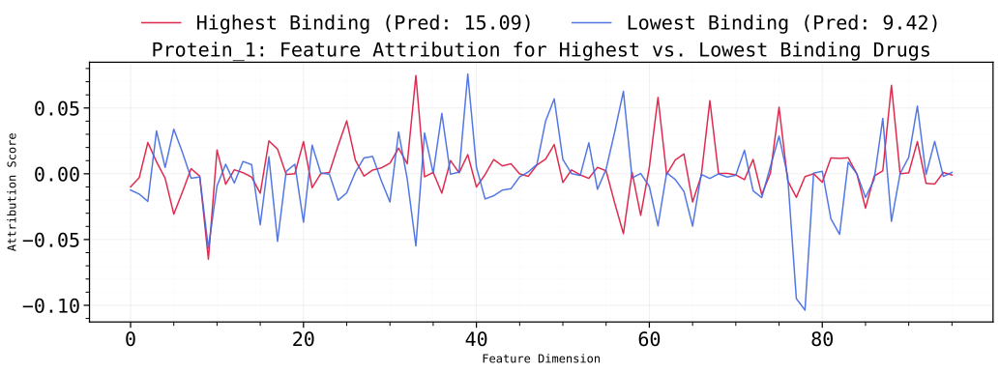


Displaying plot for: 'Protein_1: Attention Gain for High-Binding Drug (High > Low)'


/tmp/ipykernel_26982/105560525.py:70: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig_high.show()


Displaying plot for: 'Protein_1: Attention Gain for Low-Binding Drug (Low > High)'


/tmp/ipykernel_26982/105560525.py:86: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig_low.show()



--- Comparison for Protein_2 ---
Highest-binding drug: NC(COc1cncc(-c2ccc3cnccc3c2)c1)Cc1c[nH]c2ccccc12 (Prediction: 14.6944)
Lowest-binding drug:  NC(N)=NCCCC(N)C(=O)NCCNCCCCCNC1=C(c2cc3ccccc3[nH]2)C(=O)NC1=O (Prediction: 9.8003)


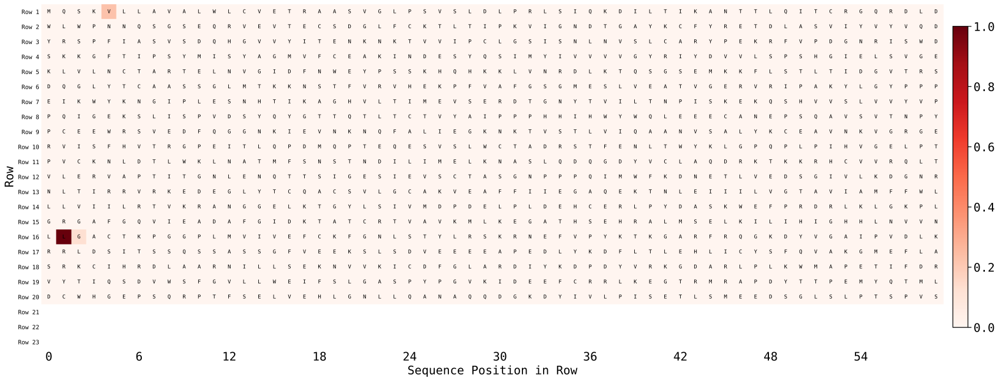

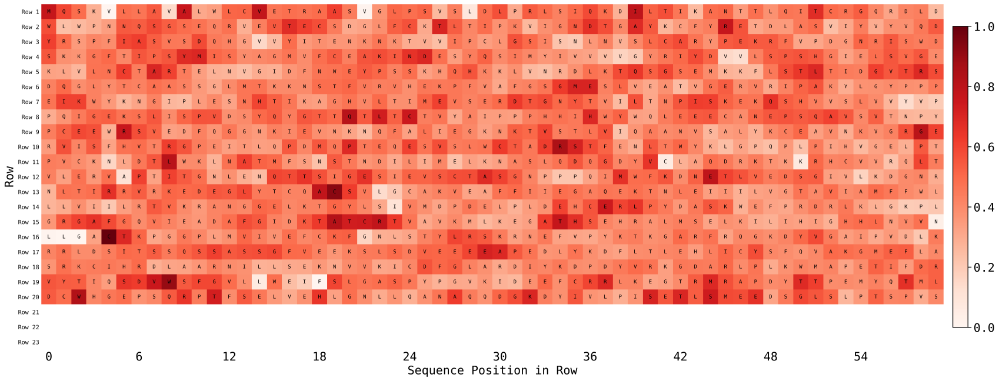

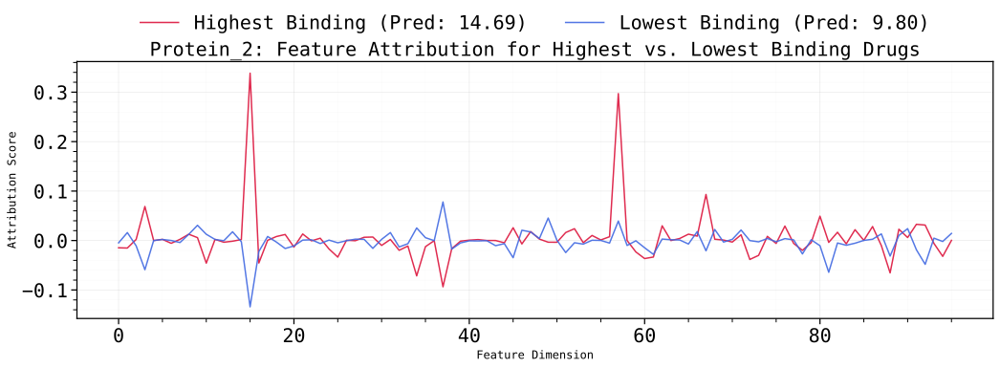


Displaying plot for: 'Protein_2: Attention Gain for High-Binding Drug (High > Low)'
Displaying plot for: 'Protein_2: Attention Gain for Low-Binding Drug (Low > High)'


/tmp/ipykernel_26982/105560525.py:70: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig_high.show()
/tmp/ipykernel_26982/105560525.py:86: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig_low.show()



--- Comparison for Protein_3 ---
Highest-binding drug: NC(=[NH2+])SCCCn1cc(C2=C(c3cccc4ccccc34)C(=O)NC2=O)c2ccccc21.[Br-] (Prediction: 14.0635)
Lowest-binding drug:  N#Cc1cnc2cnc(NCCN3CCOCC3)cc2c1Nc1ccc(Sc2ccccc2)cc1 (Prediction: 9.4917)


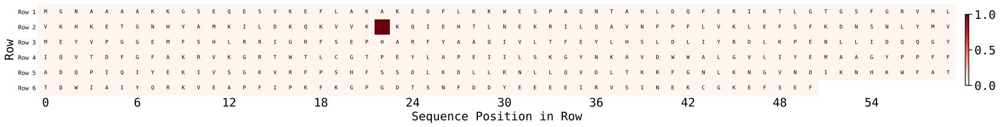

KeyboardInterrupt: 

In [22]:
for protein_name, result_data in results.items():
    print(f"\n--- Comparison for {protein_name} ---")
    
    data = result_data['data']
    protein_output_dir = os.path.join(OUTPUT_DIR, protein_name)

    # Ensure there are results to process
    if not data['predictions']:
        print(f"No results to process for {protein_name}.")
        continue
        
    # --- Find indices for highest and lowest binding affinity ---
    predictions = np.array(data['predictions'])
    highest_binding_idx = np.argmax(predictions)
    lowest_binding_idx = np.argmin(predictions)
    
    # Get the corresponding data
    highest_binding_smiles = data['smiles'][highest_binding_idx]
    lowest_binding_smiles = data['smiles'][lowest_binding_idx]
    
    print(f"Highest-binding drug: {highest_binding_smiles} (Prediction: {predictions[highest_binding_idx]:.4f})")
    print(f"Lowest-binding drug:  {lowest_binding_smiles} (Prediction: {predictions[lowest_binding_idx]:.4f})")
    
    # --- Plot 1: Feature Attribution Comparison ---
    highest_binding_attr = data['attributions'][highest_binding_idx]
    lowest_binding_attr = data['attributions'][lowest_binding_idx]
    
    fig, ax = get_styled_figure_ax(figsize=(15, 6), aspect='none', grid=True)
    x_axis = np.arange(len(highest_binding_attr))
    
    ax.plot(x_axis, highest_binding_attr, label=f'Highest Binding (Pred: {predictions[highest_binding_idx]:.2f})', color='crimson', alpha=0.9, linewidth=1.5)
    ax.plot(x_axis, lowest_binding_attr, label=f'Lowest Binding (Pred: {predictions[lowest_binding_idx]:.2f})', color='royalblue', alpha=0.9, linewidth=1.5)
    
    ax.set_title(f'{protein_name}: Feature Attribution for Highest vs. Lowest Binding Drugs')#, fontsize=16)
    ax.set_xlabel('Feature Dimension', fontsize=12)
    ax.set_ylabel('Attribution Score', fontsize=12)
    #ax.axhline(0, color='grey', linestyle='--', linewidth=0.8)
    #ax.grid(True, linestyle='--', alpha=0.6)
    style_legend(ax, bbox_to_anchor=(0.5, 1.25))
    
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "high_vs_low_binding_attribution.svg"))
    plt.show()
    plt.close(fig)

    # --- Plot 2: Protein Attention Difference (Split into Two Plots) ---
    
    # Get the corresponding attention CAMs
    highest_binding_cam = data['cams'][highest_binding_idx]
    lowest_binding_cam = data['cams'][lowest_binding_idx]
    
    # Calculate the difference
    attention_difference = highest_binding_cam - lowest_binding_cam
    
    # Get the amino acid sequence as a list of characters
    seq_letters = list(result_data['sequence'])
    
    # PLOT 2a: Where HIGH-binding drug pays MORE attention
    # We take the positive part of the difference. np.maximum clips all negative values to 0.
    attention_gain_high = np.maximum(0, attention_difference)
    title_high = f'{protein_name}: Attention Gain for High-Binding Drug (High > Low)'
    
    print(f"\nDisplaying plot for: '{title_high}'")
    fig_high = plot_sequence_attention(
        seq_letters,
        attention_gain_high,
        max_per_row=60,
        title=title_high
    )
    fig_high.show()

    # PLOT 2b: Where LOW-binding drug pays MORE attention
    # We invert the difference and take the positive part.
    attention_gain_low = np.maximum(0, -attention_difference)
    title_low = f'{protein_name}: Attention Gain for Low-Binding Drug (Low > High)'

    print(f"Displaying plot for: '{title_low}'")
    fig_low = plot_sequence_attention(
        seq_letters,
        attention_gain_low,
        max_per_row=60,
        title=title_low
    )
    fig_low.show()


## 7. Custom Visualization Function for Diverging Data

The default `plot_sequence_attention` normalizes data to a 0-1 scale, which is not suitable for showing negative and positive differences.
We will create a new function, `plot_sequence_attention_diverging`, that handles this correctly by using a diverging colormap centered at zero.


In [19]:

import plotly.graph_objects as go

def plot_sequence_attention_diverging(seq_letters, attention_weights, max_per_row=60, title="Protein Sequence with Attention"):
    """
    Plots protein sequence attention using a diverging colormap suitable for data with
    positive and negative values (e.g., differences).
    
    Args:
        seq_letters (list): List of amino acid letters (strings).
        attention_weights (np.array): Array of attention values, can be positive or negative.
        max_per_row (int): Number of amino acids per row.
        title (str): Title for the plot.
    """
    weights = np.array(attention_weights)
    
    # Determine number of rows and prepare data grid
    seq_len = len(seq_letters)
    n_rows = (seq_len + max_per_row - 1) // max_per_row
    
    z_data = np.full((n_rows, max_per_row), np.nan) # Use NaN for padding, which plotly ignores
    text_data = np.full((n_rows, max_per_row), '', dtype=object)

    for idx, (letter, weight) in enumerate(zip(seq_letters, weights)):
        row, col = idx // max_per_row, idx % max_per_row
        z_data[row, col] = weight
        text_data[row, col] = letter

    # Create Plotly heatmap with a diverging colorscale
    fig = go.Figure(data=go.Heatmap(
        z=z_data,
        text=text_data,
        texttemplate="%{text}",
        textfont={"size": 12, "color": "black"},
        colorscale='RdBu_r',  # Red-Blue diverging scale (Red for positive, Blue for negative)
        zmid=0,              # Center the color scale on zero
        showscale=True,
        xgap=1, ygap=1,
        colorbar=dict(title='Attention Diff')
    ))

    fig.update_layout(
        title=title,
        xaxis_title=f"Sequence Position (modulo {max_per_row})",
        yaxis_title="Row",
        yaxis=dict(autorange='reversed', tickvals=[]),
        xaxis=dict(tickmode='array', tickvals=list(range(0, max_per_row, 5))),
        height=max(400, n_rows * 35 + 100),
        width=max(800, max_per_row * 20)
    )
    
    return fig


## 8. High vs. Low Binding Comparison (with Diverging Plot)


--- Comparison for Protein_1 ---
Highest-binding drug: COc1cc(O)c2c(=O)oc3c(O)c(O)cc(C)c3c2c1 (Prediction: 15.0869)
Lowest-binding drug:  Oc1ccc2oc3ncc(O)c(-c4ccccc4)c3c2c1 (Prediction: 9.4151)


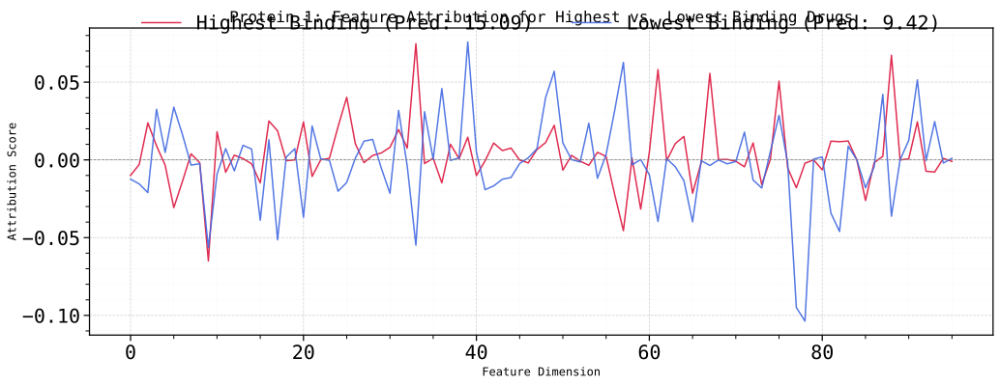


Displaying single diverging plot for Protein_1:
Red regions = High-binding drug has more attention.
Blue regions = Low-binding drug has more attention.


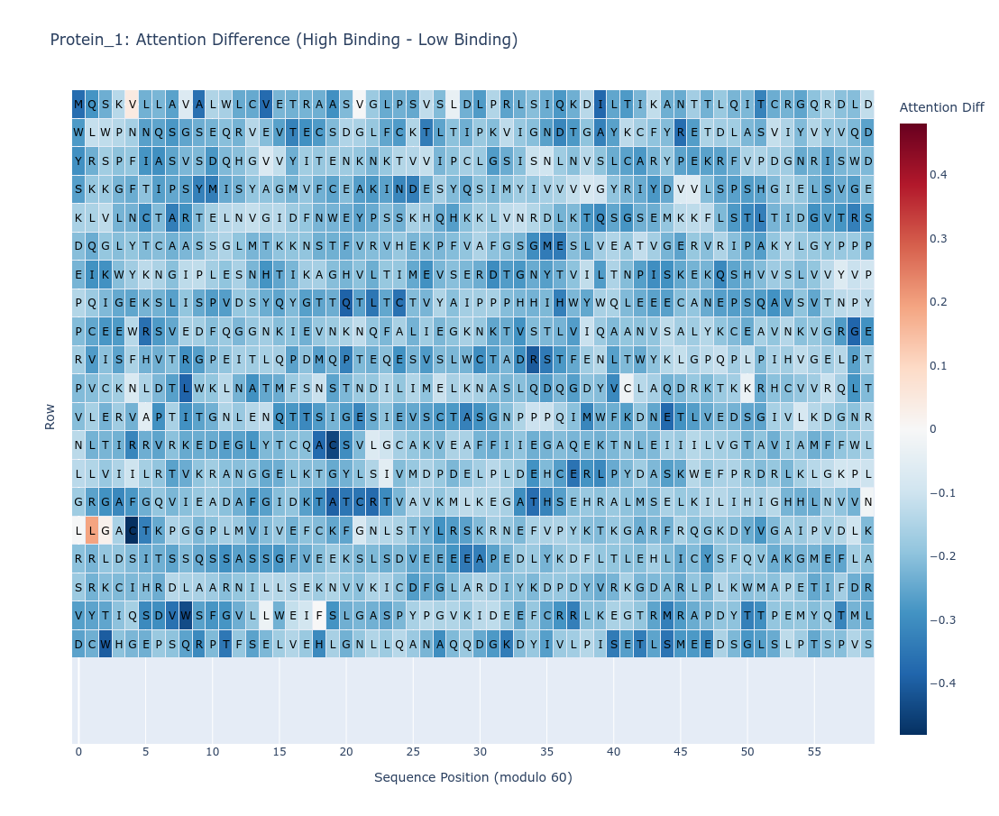


--- Comparison for Protein_2 ---
Highest-binding drug: NC(COc1cncc(-c2ccc3cnccc3c2)c1)Cc1c[nH]c2ccccc12 (Prediction: 14.6944)
Lowest-binding drug:  NC(N)=NCCCC(N)C(=O)NCCNCCCCCNC1=C(c2cc3ccccc3[nH]2)C(=O)NC1=O (Prediction: 9.8003)


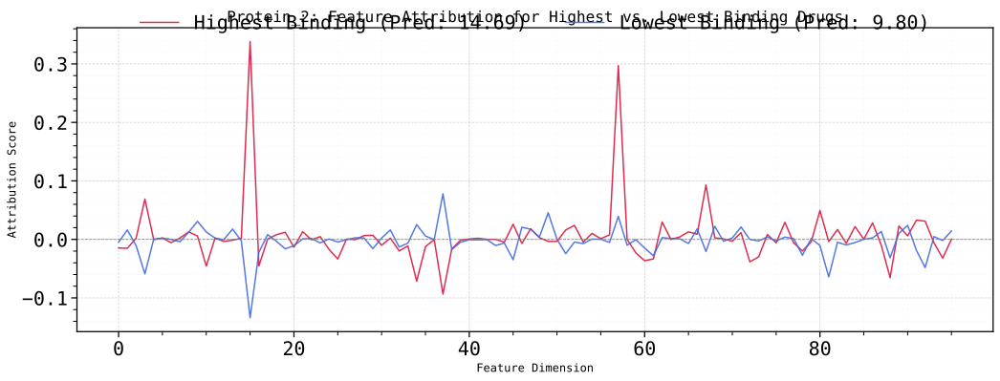


Displaying single diverging plot for Protein_2:
Red regions = High-binding drug has more attention.
Blue regions = Low-binding drug has more attention.


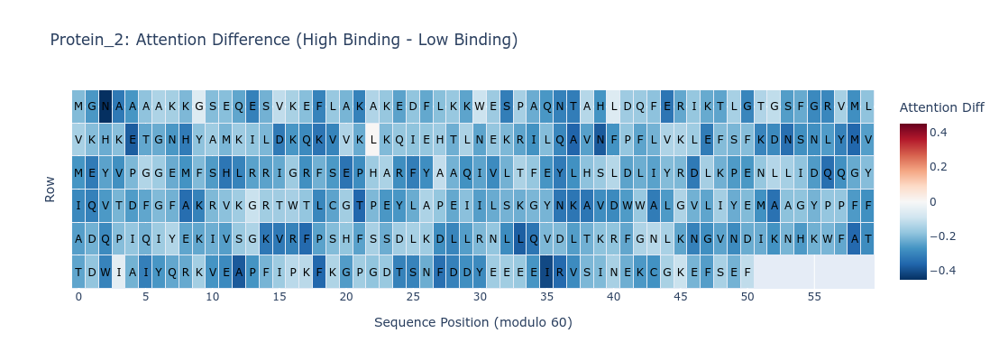


--- Comparison for Protein_3 ---
Highest-binding drug: NC(=[NH2+])SCCCn1cc(C2=C(c3cccc4ccccc34)C(=O)NC2=O)c2ccccc21.[Br-] (Prediction: 14.0635)
Lowest-binding drug:  N#Cc1cnc2cnc(NCCN3CCOCC3)cc2c1Nc1ccc(Sc2ccccc2)cc1 (Prediction: 9.4917)


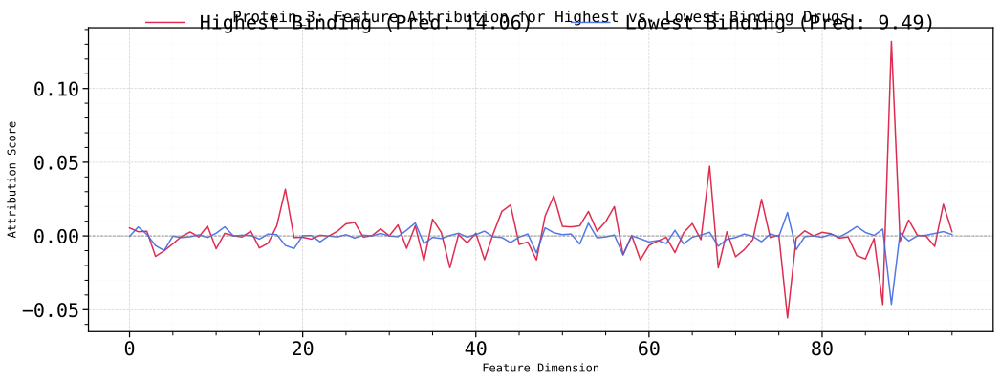


Displaying single diverging plot for Protein_3:
Red regions = High-binding drug has more attention.
Blue regions = Low-binding drug has more attention.


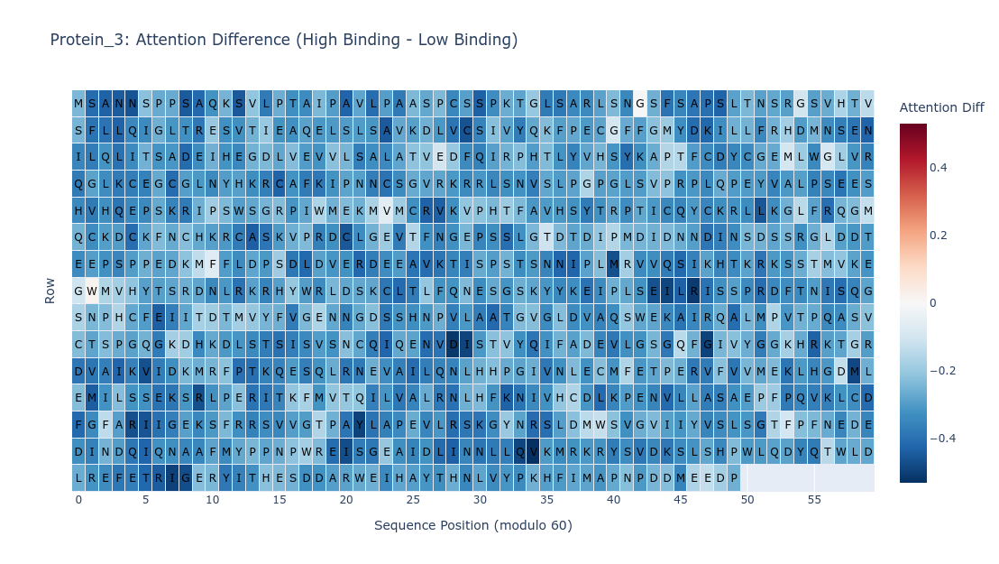


--- Comparison for Protein_4 ---
Highest-binding drug: O=C1NC(=O)C(c2cnc3ccccn23)=C1c1cn2c3c(cccc13)CN(C(=O)N1CCOCC1)CC2 (Prediction: 14.9049)
Lowest-binding drug:  O=C1NCc2c1cccc2-c1cccs1 (Prediction: 10.2829)


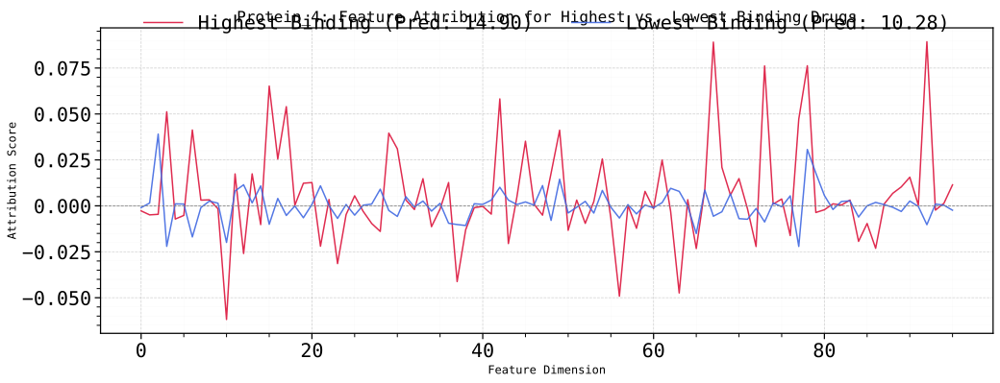


Displaying single diverging plot for Protein_4:
Red regions = High-binding drug has more attention.
Blue regions = Low-binding drug has more attention.


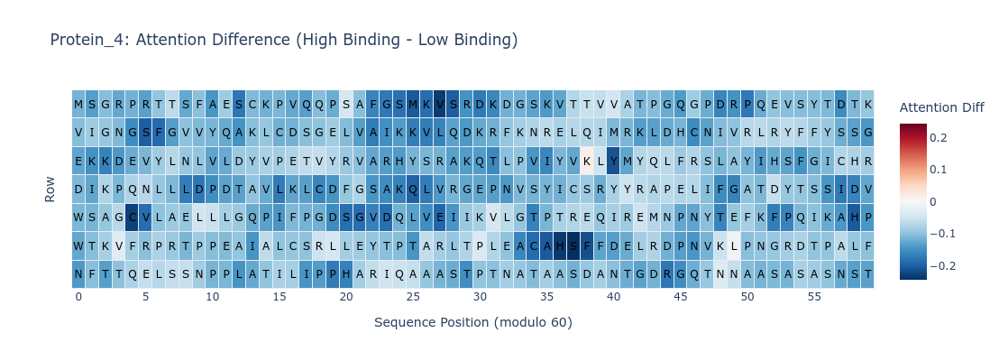


--- Comparison for Protein_5 ---
Highest-binding drug: COc1cc(O)c2c(=O)oc3c(O)c(O)cc(C)c3c2c1 (Prediction: 15.0932)
Lowest-binding drug:  N#Cc1cnc2cnc(NCCN3CCOCC3)cc2c1Nc1ccc(Cc2ccccc2)cc1 (Prediction: 10.1588)


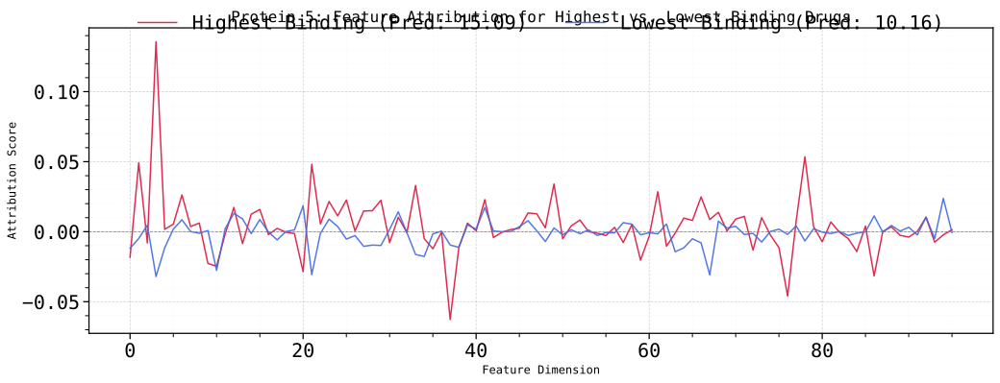


Displaying single diverging plot for Protein_5:
Red regions = High-binding drug has more attention.
Blue regions = Low-binding drug has more attention.


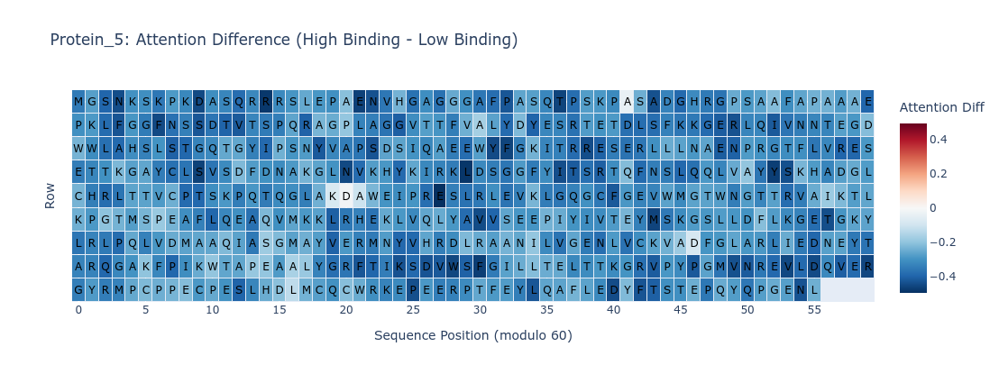

In [24]:


for protein_name, result_data in results.items():
    print(f"\n--- Comparison for {protein_name} ---")
    
    data = result_data['data']
    protein_output_dir = os.path.join(OUTPUT_DIR, protein_name)

    if not data['predictions']:
        print(f"No results to process for {protein_name}.")
        continue
        
    # --- Find indices and data for highest and lowest binding affinity ---
    predictions = np.array(data['predictions'])
    highest_binding_idx = np.argmax(predictions)
    lowest_binding_idx = np.argmin(predictions)
    
    highest_binding_smiles = data['smiles'][highest_binding_idx]
    lowest_binding_smiles = data['smiles'][lowest_binding_idx]
    
    print(f"Highest-binding drug: {highest_binding_smiles} (Prediction: {predictions[highest_binding_idx]:.4f})")
    print(f"Lowest-binding drug:  {lowest_binding_smiles} (Prediction: {predictions[lowest_binding_idx]:.4f})")
    
    # --- Plot 1: Feature Attribution Comparison ---
    highest_binding_attr = data['attributions'][highest_binding_idx]
    lowest_binding_attr = data['attributions'][lowest_binding_idx]
    
    fig, ax = get_styled_figure_ax(figsize=(15, 6), aspect='none', grid=True)
    x_axis = np.arange(len(highest_binding_attr))
    
    ax.plot(x_axis, highest_binding_attr, label=f'Highest Binding (Pred: {predictions[highest_binding_idx]:.2f})', color='crimson', alpha=0.9, linewidth=1.5)
    ax.plot(x_axis, lowest_binding_attr, label=f'Lowest Binding (Pred: {predictions[lowest_binding_idx]:.2f})', color='royalblue', alpha=0.9, linewidth=1.5)
    
    ax.set_title(f'{protein_name}: Feature Attribution for Highest vs. Lowest Binding Drugs', fontsize=16)
    ax.set_xlabel('Feature Dimension', fontsize=12)
    ax.set_ylabel('Attribution Score', fontsize=12)
    ax.axhline(0, color='grey', linestyle='--', linewidth=0.8)
    ax.grid(True, linestyle='--', alpha=0.6)
    style_legend(ax)
    
    plt.tight_layout()
    plt.savefig(os.path.join(protein_output_dir, "high_vs_low_binding_attribution.svg"))
    plt.show()
    plt.close(fig)

    # --- Plot 2: Protein Attention Difference (Using Custom Diverging Plot) ---
    
    highest_binding_cam = data['cams'][highest_binding_idx]
    lowest_binding_cam = data['cams'][lowest_binding_idx]
    attention_difference = highest_binding_cam - lowest_binding_cam
    seq_letters = list(result_data['sequence'])
    title = f'{protein_name}: Attention Difference (High Binding - Low Binding)'
    
    # Use our new custom plotting function
    fig_diff = plot_sequence_attention_diverging(
        seq_letters,
        attention_difference,
        max_per_row=60,
        title=title
    )
    
    print(f"\nDisplaying single diverging plot for {protein_name}:")
    print("Red regions = High-binding drug has more attention.")
    print("Blue regions = Low-binding drug has more attention.")
    fig_diff.show()
    
    # Save the interactive plot and a static version
    fig_diff.write_html(os.path.join(protein_output_dir, "attention_difference_diverging.html"))
    #fig_diff.write_image(os.path.join(protein_output_dir, "attention_difference_diverging.svg"))

## 9. Ligand GNN Explanations
 
Here we take one protein from our analysis and visualize the GNN explanations for each of its interacting ligands.
We compare the atom importance from the main explainer (`clourMol`) with the GNN-specific explanation.

In [14]:

from collections import Counter
import pandas as pd
from MGraphDTA.visualization.visualization_mgnn import clourMol
import base64
from io import BytesIO
from matplotlib.colors import ListedColormap

from torch_geometric.explain import Explainer as PyGExplainer
from torch_geometric.explain.algorithm import GNNExplainer as PyGGNNExplainer
from torch_geometric.explain.config import ModelConfig, ExplanationType
from torch_geometric.data import Data
from rdkit.Chem import rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D

def _create_mol_visualization_notebook(mol, node_mask):
    """A self-contained version of the molecular visualization logic for the notebook."""
    node_importance = node_mask.cpu().numpy().flatten()
    node_importance = (node_importance - node_importance.min()) / (node_importance.max() - node_importance.min() + 1e-8)
    
    highlight_atoms = list(range(mol.GetNumAtoms()))
    atom_colors = {}
    for i, importance in enumerate(node_importance):
        color = plt.cm.RdYlBu_r(importance)
        atom_colors[i] = (color[0], color[1], color[2])
    
    rdDepictor.Compute2DCoords(mol)
    drawer = rdMolDraw2D.MolDraw2DCairo(400, 400)
    drawer.DrawMolecule(mol, highlightAtoms=highlight_atoms, highlightAtomColors=atom_colors)
    drawer.FinishDrawing()
    img_data = drawer.GetDrawingText()
    return base64.b64encode(img_data).decode('utf-8')

def get_gnn_explanation_stateless(main_model, smiles, protein_seq, device='cpu'):
    """A stateless function to perform GNN explanation for a single graph."""
    data, (g, mol) = dataset.transform_unique(smiles, protein_seq)
    data = data.to(device)

    class LigandOnlyModel(torch.nn.Module):
        def __init__(self, full_model):
            super().__init__(); self.ligand_encoder = full_model.ligand_encoder
        def forward(self, x, edge_index, batch=None, **kwargs):
            return self.ligand_encoder(Data(x=x, edge_index=edge_index, batch=batch))

    ligand_model = LigandOnlyModel(main_model).to(device); ligand_model.eval()

    explainer = PyGExplainer(
        model=ligand_model,
        algorithm=PyGGNNExplainer(epochs=200),
        explanation_type='model', node_mask_type='object', edge_mask_type=None,
        model_config=ModelConfig(mode='regression', task_level='graph', return_type='raw')
    )
    explanation = explainer(x=data.x, edge_index=data.edge_index)
    
    node_mask = explanation.node_mask
    node_importance = node_mask.cpu().numpy().flatten()
    top_indices = np.argsort(node_importance)[::-1]
    top_nodes = [{'label': f"{mol.GetAtomWithIdx(int(idx)).GetSymbol()}_{idx}", 'importance': float(node_importance[idx])} for idx in top_indices]
        
    img_b64 = _create_mol_visualization_notebook(mol, node_mask)
    return {'mol_visualization': {'image_base64': img_b64}, 'top_nodes': top_nodes}

def cleanup_model_state(model):
    """
    Resets the state of a PyTorch model by clearing gradients, removing registered hooks,
    and running garbage collection. This is crucial for explainability methods that
    might leave hooks or gradients that interfere with subsequent runs.
    """
    if not isinstance(model, torch.nn.Module):
        print("Warning: cleanup_model_state called with a non-PyTorch model.")
        return

    # Set model to evaluation mode
    model.eval()

    # Recursively remove all hooks from the model
    for module in model.modules():
        if hasattr(module, '_forward_hooks'):
            module._forward_hooks.clear()
        if hasattr(module, '_backward_hooks'):
            module._backward_hooks.clear()
        if hasattr(module, '_forward_pre_hooks'):
            module._forward_pre_hooks.clear()

    # Clear gradients from all parameters
    for param in model.parameters():
        if param.grad is not None:
            try:
                param.grad.detach_()
                param.grad.zero_()
            except Exception as e:
                print(f"Could not clean gradients for a parameter: {e}")

    # Hint to Python to run garbage collection
    gc.collect()

    # Clear CUDA cache if available
    if torch.cuda.is_available():
        torch.cuda.empty_cache()



print("Stateless GNN explanation function is defined and ready.")

Stateless GNN explanation function is defined and ready.


## 🔥🖊️ Choose protein

In [15]:
_sequence = 'MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST'
PROTEIN_NAME = ''
for protein_name in results:
    if results[protein_name]['sequence'] == _sequence:
        for s in results[protein_name]['data']['smiles']:
            print(protein_name, 'tested against', s)
        PROTEIN_NAME = protein_name
        break

print("PROTEIN_NAME =", PROTEIN_NAME)

N_TOP_LIGANDS = 10
target_protein_name = PROTEIN_NAME
target_protein_data = results.get(target_protein_name)
if target_protein_data:
    protein_seq = target_protein_data['sequence']
    df_ligand = pd.DataFrame(target_protein_data['data'])
    df_ligand['original_index'] = df_ligand.index
    df_ligand = df_ligand.sort_values('predictions', ascending=False).reset_index(drop=True) # KIBA score: higher = higher affinity
    top_k_ligands = df_ligand.head(N_TOP_LIGANDS)
    bottom_k_ligands = df_ligand.tail(N_TOP_LIGANDS)
    print(f"Data selected for {target_protein_name}.")

os.makedirs(os.path.join(OUTPUT_DIR, target_protein_name), exist_ok=True)

Protein_4 tested against CC(C)(C(N)=O)n1cc(-c2cnc(N)c3c(-c4ccc(NC(=O)Nc5cccc(F)c5)cc4)csc23)cn1
Protein_4 tested against COc1cc2ncnc(Nc3cccc(Cl)c3F)c2cc1CN(C)C1(C(N)=O)CN(C(C)C)C1
Protein_4 tested against NC(=O)c1cc2c(-c3cc(C(F)(F)F)cc(C(F)(F)F)c3)cncc2s1
Protein_4 tested against CC1=C2CCCC(NNC(=O)Cc3cccc4ccccc34)=C2C=CC1=O
Protein_4 tested against CCOC(=O)C1=C(N)n2c(sc(=Cc3cccs3)c2=O)=C(C(N)=O)C1c1cccs1
Protein_4 tested against O=C(Cc1ccccc1)Nc1cccc(-c2nc3sccn3c2-c2ccnc(Nc3ccc(N4CCOCC4)cc3)n2)c1
Protein_4 tested against COc1nccc(-c2c(-c3ccc(F)cc3)ncn2C2CCC(O)CC2)n1
Protein_4 tested against CN1CCN(c2nc(C3=C(c4c[nH]c5ccccc45)C(=O)NC3=O)c3ccccc3n2)CC1
Protein_4 tested against O=c1ncc(I)c2[nH]c(-c3cccc(Cl)c3)cn12
Protein_4 tested against CCC(N)(C#Cc1cnc(N)c2c(-c3ccc(NC(=O)Nc4cccc(C)c4)cc3)csc12)CC
Protein_4 tested against O=c1cc(-c2ccncc2)[nH]c(NCc2cc(F)cc(F)c2)n1
Protein_4 tested against NC(=O)c1ccc(-c2ccncc2)cc1NCc1cccc(F)c1
Protein_4 tested against CN(C)CC(C)(C)CNc1nccc(-c2c(-c3ccc(F)c

## 10. Visualizing Top/Bottom K Ligand Explanations
 
Here we generate the side-by-side GNN visualizations, but only for the selected Top-K highest- and Bottom-K lowest-binding drugs.


Data selected for Protein_4.

--- Visualizing Top_K_Highest_Binding for Protein_4 ---


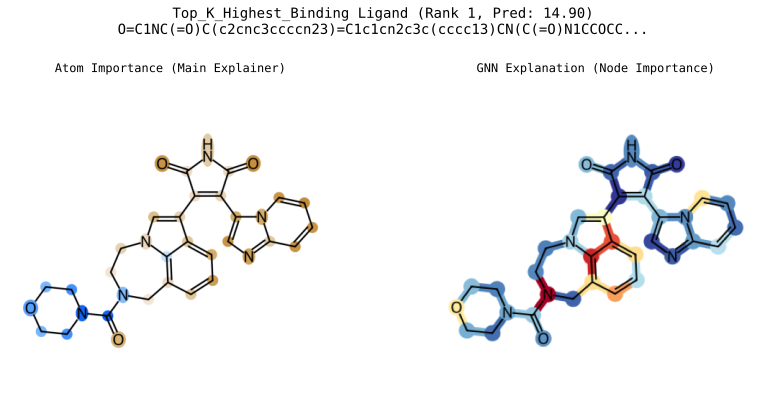

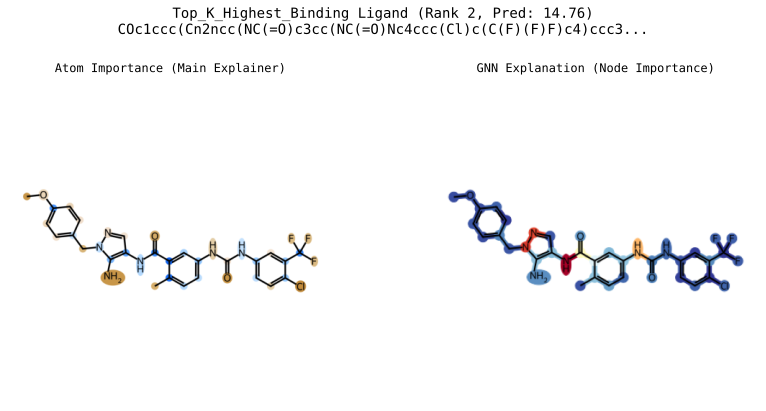

KeyboardInterrupt: 

In [18]:
def plot_ligand_comparison(ligands_df, group_name, protein_seq, protein_name):
    """Helper function to plot GNN comparisons for a group of ligands."""
    print(f"\n--- Visualizing {group_name} for {protein_name} ---")
    ligand_output_dir = os.path.join(OUTPUT_DIR, protein_name, "ligand_visualizations")
    os.makedirs(ligand_output_dir, exist_ok=True)
    
    for i, row in ligands_df.iterrows():
        smiles, pred_value, original_idx = row['smiles'], row['predictions'], row['original_index']
        
        #cleanup_model_state(model)
        output_dict = explainer.explain(smiles_input=smiles, protein_input=protein_seq)
        mol = output_dict.get('mol_obj')
        if not mol: continue
        
        atom_att = output_dict['atom_att']
        bottom = plt.get_cmap('Blues_r', 256); top = plt.get_cmap('Oranges', 256)
        newcolors = np.vstack([bottom(np.linspace(0.35, 0.85, 128)), top(np.linspace(0.15, 0.65, 128))])
        newcmp = ListedColormap(newcolors, name='OrangeBlue')
        atom_color = {idx: newcmp(atom_att[idx])[:3] for idx in range(len(atom_att))}
        ref_study_img = clourMol(mol, highlightAtoms_p=range(len(atom_att)), highlightAtomColors_p=atom_color, radii={k: 0.2 for k in range(len(atom_att))})

        try:
            gnn_output = get_gnn_explanation_stateless(model, smiles, protein_seq, device=device)
            gnn_img_b64 = gnn_output.get('mol_visualization', {}).get('image_base64')
            gnn_img = plt.imread(BytesIO(base64.b64decode(gnn_img_b64))) if gnn_img_b64 else None
        except Exception as e:
            print(f"Error in stateless GNN explanation for {smiles}: {e}"); gnn_img = None

        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        axes[0].imshow(ref_study_img); axes[0].set_title('Atom Importance (Main Explainer)'); axes[0].axis('off')
        if gnn_img is not None: axes[1].imshow(gnn_img); axes[1].set_title('GNN Explanation (Node Importance)')
        else: axes[1].text(0.5, 0.5, 'GNN Viz Not Available', ha='center', va='center')
        axes[1].axis('off')
        fig.suptitle(f'{group_name} Ligand (Rank {row.name+1}, Pred: {pred_value:.2f})\n{smiles[:60]}...', fontsize=14)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95]); plt.savefig(os.path.join(ligand_output_dir, f"{group_name}_{row.name}.svg"))
        plt.show(); plt.close(fig)

if 'top_k_ligands' in locals():
    plot_ligand_comparison(top_k_ligands, "Top_K_Highest_Binding", protein_seq, target_protein_name)
    plot_ligand_comparison(bottom_k_ligands, "Top_K_Lowest_Binding", protein_seq, target_protein_name)

## 11. Aggregate Atom Importance Comparison
 
To compare the groups, we find the top 3 most important atoms for each drug, as identified by the GNN explainer. We then count the frequency of each atom type (e.g., C, O, N) in these top spots to see if high-binding drugs rely on different atoms than low-binding drugs.


In [ ]:

def get_top_atom_types(ligands_df, protein_seq, num_top_atoms=3):
    atom_counts = Counter()
    for i, row in ligands_df.iterrows():
        try:
            gnn_output = get_gnn_explanation_stateless(model, row['smiles'], protein_seq, device=device)
            top_nodes = gnn_output.get('top_nodes', [])[:num_top_atoms]
            for node in top_nodes:
                atom_type = node['label'].split('_')[0]
                atom_counts[atom_type] += 1
        except Exception as e:
            print(f"Could not get GNN output for {row['smiles']}: {e}")
    return atom_counts

if 'top_k_ligands' in locals():
    high_binding_atom_counts = get_top_atom_types(top_k_ligands, protein_seq)
    low_binding_atom_counts = get_top_atom_types(bottom_k_ligands, protein_seq)
    df_high = pd.DataFrame(list(high_binding_atom_counts.items()), columns=['Atom', 'Count']).assign(Group='High-Binding')
    df_low = pd.DataFrame(list(low_binding_atom_counts.items()), columns=['Atom', 'Count']).assign(Group='Low-Binding')
    df_counts = pd.concat([df_high, df_low])
    if not df_counts.empty:
        fig, ax = get_styled_figure_ax(figsize=(12, 7), aspect='none', grid=True)
        sns.barplot(data=df_counts, x='Atom', y='Count', hue='Group', ax=ax, palette=['crimson', 'royalblue'])
        ax.set_title(f'Frequency of Top 3 Important Atom Types for {target_protein_name}', fontsize=16)
        ax.set_ylabel('Total Count in Top 3'); style_legend(ax)
        plt.tight_layout(); plt.show()
    else: print("No atom importance data to plot.")

In [24]:
top_k_ligands

,smiles,predictions,cams,attributions,original_index
0,O=C1NC(=O)C(c2cnc3ccccn23)=C1c1cn2c3c(cccc13)C...,14.904852,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0027355675, -0.004900723, -0.004596868, 0....",176
1,COc1ccc(Cn2ncc(NC(=O)c3cc(NC(=O)Nc4ccc(Cl)c(C(...,14.760267,"[0.10917749, 0.1984353, 0.15877452, 0.243885, ...","[-0.0015745431, 0.009803826, -0.05802411, -0.0...",22
2,CC(C)OC(=O)N1CCn2cc(C3=C(c4cnc5ccccn45)C(=O)NC...,14.381493,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0011938023, -0.0036783672, 0.15535367, 0.1...",209
3,O=C(O)c1ccccc1Nc1ccnc(Nc2cccc(F)c2)n1,14.217157,"[0.16666664, 0.07634894, 0.048214506, 0.026685...","[0.0032887873, -0.012538919, -0.012972877, -0....",24
4,O=C1Nc2ccccc2C1=Cc1cn[nH]c1-c1ccccc1[N+](=O)[O-],14.056494,"[0.15648584, 0.14986539, 0.15847662, 0.1639006...","[-7.093118e-05, 0.01154138, 0.015915573, -0.01...",149
5,CCN1CCN(CCCC(=O)Nc2n[nH]c3nnc(-c4cccc(F)c4F)cc...,13.571142,"[0.059665103, 0.17471786, 0.22219598, 0.091446...","[0.004036111, -0.002713459, 0.031074332, 0.084...",138
6,Nc1n[nH]c2ccc(-c3nnn(Cc4ccccc4)c3-c3ccc(F)cc3)...,13.525217,"[0.15304047, 0.068350255, 0.11095015, 0.051007...","[0.003586119, -0.016184904, 0.06987484, -0.070...",99
7,COc1ccc(CNc2cc(-c3c[nH]c4ncccc34)cc(F)n2)cc1,13.517260,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0013948539, -0.0033294382, 0.21610977, 0.02...",111
8,CN(c1ncccc1CNc1nc(Nc2ccc3c(c2)CC(=O)N3)ncc1C(F...,13.497972,"[0.4188175, 0.32983693, 0.21270902, 0.18629928...","[-0.0045237597, -0.008816448, 0.014746676, -0....",55
9,Nc1n[nH]c2ccc(-c3nnn(Cc4ccccc4)c3C3CC3)cc12,13.462635,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0028982505, -0.0087616965, 0.0919231, -0.0...",101


In [25]:
bottom_k_ligands

,smiles,predictions,cams,attributions,original_index
200,COCCC(C(N)=O)N(C)Cc1cc2c(Nc3cccc(Cl)c3F)ncnc2c...,11.105209,"[0.10285642, 0.15409546, 0.14715925, 0.1226043...","[-0.0001212452, 0.000102962076, 0.0052970937, ...",78
201,CCNc1nnc2ccc(-c3ocnc3-c3ccc(F)cc3)cn12,11.102902,"[0.24005751, 0.20921503, 0.16168402, 0.1835334...","[-3.1449123e-05, -3.3012282e-05, 0.0015248477,...",155
202,COc1cc2ncnc(Nc3cccc(Cl)c3F)c2cc1CN(C)C1(C(N)=O...,11.089368,"[0.11189025, 0.197182, 0.109660834, 0.16666664...","[-8.41722e-06, 0.00018574648, 0.007140427, -0....",1
203,Cc1cccc(-c2[nH]ncc2-c2ccc3ncccc3n2)n1,11.085667,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0061034868, -0.0060687168, 0.025477136, 0....",199
204,COc1ccccc1CNc1ncc(C(=O)NC2CCN(C)CC2)c(NC2CCCC2)n1,10.596028,"[0.18368363, 0.21149206, 0.23691374, 0.1745339...","[-0.0005698284, -0.0009812532, 0.0066934936, -...",192
205,CSc1ccccc1Nc1nc(N2CCNCC2)nc2c(NCC3CC3)ncnc12,10.562555,"[0.16401933, 0.09463694, 0.092778645, 0.179563...","[-0.0009842444, -0.00091095397, 0.01592065, -0...",13
206,Cc1cccc(-c2cccc3onc(N)c23)c1,10.539117,"[0.12944901, 0.18697838, 0.22150707, 0.1908987...","[-0.00051673304, 0.0047053774, 0.017729169, -0...",39
207,Cn1cnc(CNc2cc(Br)c3ncc(C#N)c(Nc4ccc(F)c(Cl)c4)...,10.531569,"[0.07910889, 0.09004754, 0.09934688, 0.1582980...","[0.00057339424, 0.0019827175, -0.014427799, -0...",76
208,Nc1ncnc2scc(-c3ccccc3)c12,10.511027,"[0.41741654, 0.31123826, 0.36332038, 0.4544206...","[0.000520875, -0.00024003297, -0.025865227, -0...",116
209,O=C1NCc2c1cccc2-c1cccs1,10.282856,"[0.11548668, 0.13554214, 0.1041827, 0.12526001...","[-0.00096838037, 0.0015526385, 0.03904281, -0....",151


In [16]:
from rdkit import Chem

def get_substructure_smarts(mol, bit_info, bit_id):
    """
    Reconstructs the SMARTS string for a specific Morgan fingerprint bit 
    using the molecule and bitInfo dictionary.
    """
    if bit_id not in bit_info:
        return "Unknown"
    
    # Get the (atom_index, radius) for the first occurrence of this bit
    atom_idx, radius = bit_info[bit_id][0]
    
    if radius == 0:
        # Radius 0 means the substructure is just the single atom itself
        atom = mol.GetAtomWithIdx(atom_idx)
        return atom.GetSmarts()
    
    # For radius > 0, find the environment (bonds) and create a sub-molecule
    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_idx)
    amap = {}
    submol = Chem.PathToSubmol(mol, env, atomMap=amap)
    
    # Convert the sub-molecule to a SMARTS string
    return Chem.MolToSmarts(submol)

In [27]:
# This analysis identifies the specific chemical substructures that are most frequently
# important in high-binding vs. low-binding drugs. We generate Morgan fingerprints
# around the most important atoms (identified by the GNN explainer) and aggregate their
# counts. The visualization then shows a direct comparison of these counts, with the
# substructure images used as labels for clarity.

from rdkit.Chem import AllChem, Draw
from collections import Counter
import pandas as pd
from IPython.display import display, SVG

def get_important_substructures(ligands_df, protein_seq, radius=1, top_n_atoms=3): #=3
    """
    For a group of ligands, find the most common chemical substructures
    centered around the most important atoms.
    """
    substructure_counts = Counter()
    # Also store a representative molecule for each substructure ID for later drawing
    substructure_repo = {}
    
    print(f"Analyzing substructures for {len(ligands_df)} ligands...")
    for i, row in ligands_df.iterrows():
        smiles = row['smiles']
        try:
            gnn_output = get_gnn_explanation_stateless(model, smiles, protein_seq, device=device)
            top_nodes = gnn_output.get('top_nodes', [])[:top_n_atoms]
            if not top_nodes: continue
                
            important_atom_indices = [int(node['label'].split('_')[-1]) for node in top_nodes]
            
            _, (_, mol) = dataset.transform_unique(smiles, protein_seq)
            if not mol: continue

            for atom_idx in important_atom_indices:
                bit_info = {}
                AllChem.GetMorganFingerprint(mol, radius, fromAtoms=[atom_idx], bitInfo=bit_info)
                for bit_id in bit_info.keys():
                    substructure_counts[bit_id] += 1
                    if bit_id not in substructure_repo:
                        substructure_repo[bit_id] = (mol, bit_info)
                        
        except Exception as e:
            print(f"Could not process substructures for {smiles}: {e}")
            
    return substructure_counts, substructure_repo

if 'top_k_ligands' in locals():
    # This process can be slow as it runs the GNN explainer again for each drug
    high_binding_subs, high_repo = get_important_substructures(top_k_ligands, protein_seq)
    low_binding_subs, low_repo = get_important_substructures(bottom_k_ligands, protein_seq)

    # Combine all substructures found
    all_sub_ids = set(high_binding_subs.keys()) | set(low_binding_subs.keys())
    
    comp_data = []
    for sub_id in all_sub_ids:
        # Retrieve the representative molecule and info
        # We check high_repo first; if not there, it must be in low_repo
        if sub_id in high_repo:
            rep_mol, rep_info = high_repo[sub_id]
        else:
            rep_mol, rep_info = low_repo[sub_id]
        sub_name = get_substructure_smarts(rep_mol, rep_info, sub_id)
        
        comp_data.append({
            'sub_id': sub_id,
            'sub_name': sub_name, 
            'High-Binding': high_binding_subs.get(sub_id, 0),
            'Low-Binding': low_binding_subs.get(sub_id, 0)
        })
    
    df_subs = pd.DataFrame(comp_data).set_index('sub_id')
    df_subs['total'] = df_subs[['High-Binding', 'Low-Binding']].sum(axis=1)
    df_subs_copy = df_subs.copy()
    
    
    top_df = df_subs.sort_values('total', ascending=False).head(7)
    display(top_df[['sub_name', 'High-Binding', 'Low-Binding', 'total']])

Analyzing substructures for 10 ligands...


[11:38:02] DEPRECATION WARNING: please use MorganGenerator
[11:38:02] DEPRECATION WARNING: please use MorganGenerator
[11:38:02] DEPRECATION WARNING: please use MorganGenerator
[11:38:08] DEPRECATION WARNING: please use MorganGenerator
[11:38:08] DEPRECATION WARNING: please use MorganGenerator
[11:38:08] DEPRECATION WARNING: please use MorganGenerator
[11:38:13] DEPRECATION WARNING: please use MorganGenerator
[11:38:13] DEPRECATION WARNING: please use MorganGenerator
[11:38:13] DEPRECATION WARNING: please use MorganGenerator
[11:38:19] DEPRECATION WARNING: please use MorganGenerator
[11:38:19] DEPRECATION WARNING: please use MorganGenerator
[11:38:19] DEPRECATION WARNING: please use MorganGenerator
[11:38:25] DEPRECATION WARNING: please use MorganGenerator
[11:38:25] DEPRECATION WARNING: please use MorganGenerator
[11:38:25] DEPRECATION WARNING: please use MorganGenerator
[11:38:31] DEPRECATION WARNING: please use MorganGenerator
[11:38:31] DEPRECATION WARNING: please use MorganGenerat

Analyzing substructures for 10 ligands...


[11:39:00] DEPRECATION WARNING: please use MorganGenerator
[11:39:00] DEPRECATION WARNING: please use MorganGenerator
[11:39:00] DEPRECATION WARNING: please use MorganGenerator
[11:39:06] DEPRECATION WARNING: please use MorganGenerator
[11:39:06] DEPRECATION WARNING: please use MorganGenerator
[11:39:06] DEPRECATION WARNING: please use MorganGenerator
[11:39:13] DEPRECATION WARNING: please use MorganGenerator
[11:39:13] DEPRECATION WARNING: please use MorganGenerator
[11:39:13] DEPRECATION WARNING: please use MorganGenerator
[11:39:20] DEPRECATION WARNING: please use MorganGenerator
[11:39:20] DEPRECATION WARNING: please use MorganGenerator
[11:39:20] DEPRECATION WARNING: please use MorganGenerator
[11:39:28] DEPRECATION WARNING: please use MorganGenerator
[11:39:28] DEPRECATION WARNING: please use MorganGenerator
[11:39:28] DEPRECATION WARNING: please use MorganGenerator
[11:39:35] DEPRECATION WARNING: please use MorganGenerator
[11:39:35] DEPRECATION WARNING: please use MorganGenerat

,sub_name,High-Binding,Low-Binding,total
sub_id,,,,
3217380708,c,16,8,24
3218693969,c,7,3,10
2092489639,n,2,2,4
847961216,N,2,2,4
98513984,[#6]:[#6]:[#6],2,1,3
3982076256,[#6]:[#6](-[#6]):[#6],2,1,3
2132511834,[nH],1,2,3


Then visualize the results:

In [28]:
df_subs = df_subs.sort_values('total', ascending=False).head(7)

In [17]:

smarts_legend = {
    # Elements
    "c": "Aromatic Carbon",
    "n": "Aromatic Nitrogen",
    "N": "Amine / Nitrogen",
    "s": "Aromatic Sulfur",
    "o": "Aromatic Oxygen",
    "[#6]": "Aliphatic Carbon",
    "[#7]": "Nitrogen",
    "[#8]": "Oxygen",
    "[#9]": "Fluorine",
    "[#16]": "Sulfur",
    "[#17]": "Chlorine",
    
    # Common Groups
    "c1ccccc1": "Phenyl Group",
    "C(F)(F)F": "Trifluoromethyl",
    "C(=O)N": "Amide",
    "C(=O)O": "Carboxylic Acid",
    "S(=O)(=O)": "Sulfonyl",
    "N(=O)=O": "Nitro",
    "C#N": "Cyano",

    "[#6]:[#6]:[#7]": "Pyridine Fragment",
    "[#6]:[#7](:[#6]):[#6]": "Pyridine Fragment",
    "[#6]:[#6](-[#7+]):[#6]": "Pos. Charged Nitrogen",
    "[#6]-[#7]-[#6]": "Secondary Amine",
    "[#7H]:[#6](-[#6]):[#6]": "Protonated Aromatic N",

    # Sulfur/Chlorine (Low Binding)
    "[#6]:[#16]:[#6]": "Thiophene Fragment",
    "[#7]:[#6](:[#16]):[#6]": "Thiazole Fragment",
    "[#6]-[#16]-[#6]": "Thioether",
    "[#6]-[#17]": "Chloride Substituent",
    "[#6]:[#6](-[#17]):[#6]": "Chlorophenyl Fragment",
    
    # Generic Carbon (Scaffold)
    "[#6]:[#6]:[#6]": "Aromatic Carbon Chain",
    "[#6]:[#6](:[#6]):[#6]": "Aromatic Carbon Branch",
    "[#6]-[#6](:[#6]):[#6]": "Alkyl-Aromatic Link",
    "[#6]:[#6](-[#6]):[#6]": "Methyl-Aromatic Link",

    # --- NITROGENOUS (Mostly High Binding) ---
    "[#6]-[#7](-[#6])-[#6]": "Tertiary Amine",
    "[#7]:[#6](:[#6]):[#6]": "N-Substituted Heterocycle",
    "[#7]:[#7]:[#6]": "Diazine Fragment (N-N)",
    "[#6]-[#7](:[#7]):[#6]": "N-Alkyl Heterocycle",
    "[#6]:[#6](-[#7]):[#6]": "Exocyclic Amine / Aniline",
    "[#7]:[#6](-[#6]):[#6]": "Alkyl-Pyridine Motif",
    "[#7]-[#6](:[#7]):[#6]": "Amino-Heterocycle",

    # --- SULFUR & HALOGENS (Mostly Low Binding) ---
    "s": "Aromatic Sulfur",
    "[#6]-[#35]": "Bromide Substituent", 
    "[#7]:[#7H]:[#6]": "Protonated Diazo Motif (e.g., Pyrazole)",
    "[#6]:[#6](:[#6])-[#6]": "Alkyl-Substituted Aromatic",        
    "[nH]": "Protonated Aromatic Nitrogen (Gen.)",
    "[#7H]:[#6](:[#6]):[#6]": "Protonated Heterocycle Link",
}

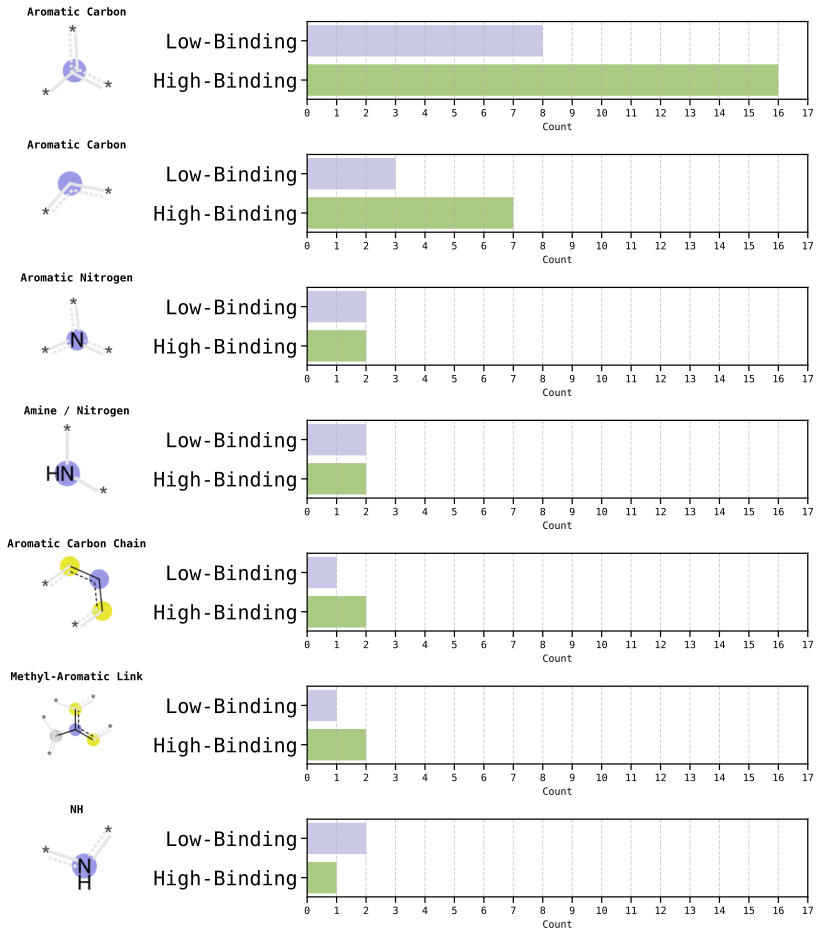

In [32]:
import matplotlib.pyplot as plt
from rdkit.Chem import Draw

# --- Create the comparative plot ---
fig, axes = plt.subplots(len(df_subs), 2, figsize=(12, 2 * len(df_subs)), 
                         gridspec_kw={'width_ratios': [1, 3]})


def format_fallback_label(text):
    """
    If a SMARTS string isn't in the legend, try to make it look 
    slightly better than raw code (e.g. remove brackets).
    """
    clean = text.replace("[", "").replace("]", "")
    if len(clean) < 5:
        return clean.upper() 
    return text

for i, (sub_id, row) in enumerate(df_subs.iterrows()):
    # 1. Draw substructure on the left axis
    ax_img = axes[i, 0]
    repo = high_repo if sub_id in high_repo else low_repo
    mol, bit_info = repo[sub_id]
    
    # RDKit draws the fragment visually here
    env = Draw.DrawMorganBit(mol, sub_id, bit_info)
    ax_img.imshow(env)
    ax_img.axis('off')
    
    raw_smarts = row['sub_name']
    
    # Logic: Try Dictionary -> Fallback to formatting -> Use Raw
    if raw_smarts in smarts_legend:
        clean_label = smarts_legend[raw_smarts]
    else:
        clean_label = format_fallback_label(raw_smarts)
    
    ax_img.set_title(f"{clean_label}", fontsize=11, fontweight='bold')

    # 2. Draw bar chart on the right axis
    ax_bar = axes[i, 1]
    counts = {'High-Binding': row['High-Binding'], 'Low-Binding': row['Low-Binding']}
    
    ax_bar.barh(list(counts.keys()), list(counts.values()), 
                color=DATASET_COLORS[:2] if 'DATASET_COLORS' in locals() else ['crimson', 'royalblue'],
                alpha=0.8)
    
    ax_bar.grid(True, axis='x', linestyle='--', alpha=0.6)
    
    max_bar_value = df_subs[['High-Binding', 'Low-Binding']].max().max()
    ax_bar.set_xticks(range(0, int(max_bar_value) + 2))
    
    ax_bar.tick_params(axis='x', labelsize=10)
    ax_bar.set_xlabel("Count", fontsize=10)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig(os.path.join(OUTPUT_DIR, target_protein_name, "top_substructure_comparison.svg"))
plt.show()

In [33]:
from rdkit import Chem

def get_raw_smarts(mol, bit_info, bit_id):
    """Reconstruct raw SMARTS from bit info for verification."""
    if bit_id not in bit_info: return "Unknown"
    atom_idx, radius = bit_info[bit_id][0]
    if radius == 0:
        return mol.GetAtomWithIdx(atom_idx).GetSmarts()
    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_idx)
    submol = Chem.PathToSubmol(mol, env)
    return Chem.MolToSmarts(submol)

print(f"{'ID':<15} | {'High':<5} | {'Low':<5} | {'Raw SMARTS'}")
print("-" * 65)

for sub_id, row in df_subs.iterrows():
    # Get the molecule and info to reconstruct the name
    repo = high_repo if sub_id in high_repo else low_repo
    mol, bit_info = repo[sub_id]
    
    # Get the raw SMARTS string
    raw_smarts = get_raw_smarts(mol, bit_info, sub_id)
    
    # Print the data row
    print(f"{sub_id:<15} | {int(row['High-Binding']):<5} | {int(row['Low-Binding']):<5} | {raw_smarts}")

ID              | High  | Low   | Raw SMARTS
-----------------------------------------------------------------
3217380708      | 16    | 8     | c
3218693969      | 7     | 3     | c
2092489639      | 2     | 2     | n
847961216       | 2     | 2     | N
98513984        | 2     | 1     | [#6]:[#6]:[#6]
3982076256      | 2     | 1     | [#6]:[#6](-[#6]):[#6]
2132511834      | 1     | 2     | [nH]


### New test with radius > 0 only

In [18]:
# This analysis identifies the specific chemical substructures that are most frequently
# important in high-binding vs. low-binding drugs. We generate Morgan fingerprints
# around the most important atoms (identified by the GNN explainer) and aggregate their
# counts. The visualization then shows a direct comparison of these counts, with the
# substructure images used as labels for clarity.

from rdkit.Chem import AllChem, Draw
from collections import Counter
import pandas as pd
from IPython.display import display, SVG

def get_important_substructures_positive_radius(ligands_df, protein_seq, radius=1, top_n_atoms=3): #=3
    """
    For a group of ligands, find the most common chemical substructures
    centered around the most important atoms.
    """
    substructure_counts = Counter()
    # Also store a representative molecule for each substructure ID for later drawing
    substructure_repo = {}
    
    print(f"Analyzing substructures for {len(ligands_df)} ligands...")
    for i, row in ligands_df.iterrows():
        smiles = row['smiles']
        try:
            gnn_output = get_gnn_explanation_stateless(model, smiles, protein_seq, device=device)
            top_nodes = gnn_output.get('top_nodes', [])[:top_n_atoms]
            if not top_nodes: continue
                
            important_atom_indices = [int(node['label'].split('_')[-1]) for node in top_nodes]
            
            _, (_, mol) = dataset.transform_unique(smiles, protein_seq)
            if not mol: continue

            for atom_idx in important_atom_indices:
                bit_info = {}
                AllChem.GetMorganFingerprint(mol, radius, fromAtoms=[atom_idx], bitInfo=bit_info)
                for bit_id in bit_info.keys():
                    atom_idx, _radius = bit_info[bit_id][0]
                    # Ignore single atoms (radius 0) so complex groups can rise to the top
                    if _radius == 0: 
                        continue
                    substructure_counts[bit_id] += 1
                    if bit_id not in substructure_repo:
                        substructure_repo[bit_id] = (mol, bit_info)
                        
        except Exception as e:
            print(f"Could not process substructures for {smiles}: {e}")
            
    return substructure_counts, substructure_repo

if 'top_k_ligands' in locals():
    # This process can be slow as it runs the GNN explainer again for each drug
    high_binding_subs, high_repo = get_important_substructures_positive_radius(top_k_ligands, protein_seq)
    low_binding_subs, low_repo = get_important_substructures_positive_radius(bottom_k_ligands, protein_seq)

    # Combine all substructures found
    all_sub_ids = set(high_binding_subs.keys()) | set(low_binding_subs.keys())
    
    comp_data = []
    for sub_id in all_sub_ids:
        # Retrieve the representative molecule and info
        # We check high_repo first; if not there, it must be in low_repo
        if sub_id in high_repo:
            rep_mol, rep_info = high_repo[sub_id]
        else:
            rep_mol, rep_info = low_repo[sub_id]
        sub_name = get_substructure_smarts(rep_mol, rep_info, sub_id)
        
        comp_data.append({
            'sub_id': sub_id,
            'sub_name': sub_name, 
            'High-Binding': high_binding_subs.get(sub_id, 0),
            'Low-Binding': low_binding_subs.get(sub_id, 0)
        })
    
    df_subs_posradius = pd.DataFrame(comp_data).set_index('sub_id')
    df_subs_posradius['total'] = df_subs_posradius[['High-Binding', 'Low-Binding']].sum(axis=1)
    
    top_df_posradius = df_subs_posradius.sort_values('total', ascending=False).head(7)
    display(top_df_posradius[['sub_name', 'High-Binding', 'Low-Binding', 'total']])

Analyzing substructures for 10 ligands...


/home/alex/dev/projects/dl_imt4392/dl_project/MGraphDTA/regression/preprocessing.py:166: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:253.)
  target=torch.LongTensor([target]),
[12:25:45] DEPRECATION WARNING: please use MorganGenerator
[12:25:45] DEPRECATION WARNING: please use MorganGenerator
[12:25:45] DEPRECATION WARNING: please use MorganGenerator
[12:25:51] DEPRECATION WARNING: please use MorganGenerator
[12:25:51] DEPRECATION WARNING: please use MorganGenerator
[12:25:51] DEPRECATION WARNING: please use MorganGenerator
[12:25:57] DEPRECATION WARNING: please use MorganGenerator
[12:25:57] DEPRECATION WARNING: please use MorganGenerator
[12:25:57] DEPRECATION WARNING: please use MorganGenerator
[12:26:02] DEPRECATION WARNING: please use MorganGenerator
[12:26:02] DEPRECATI

Analyzing substructures for 10 ligands...


[12:26:43] DEPRECATION WARNING: please use MorganGenerator
[12:26:43] DEPRECATION WARNING: please use MorganGenerator
[12:26:43] DEPRECATION WARNING: please use MorganGenerator
[12:26:49] DEPRECATION WARNING: please use MorganGenerator
[12:26:49] DEPRECATION WARNING: please use MorganGenerator
[12:26:49] DEPRECATION WARNING: please use MorganGenerator
[12:26:55] DEPRECATION WARNING: please use MorganGenerator
[12:26:55] DEPRECATION WARNING: please use MorganGenerator
[12:26:55] DEPRECATION WARNING: please use MorganGenerator
[12:27:00] DEPRECATION WARNING: please use MorganGenerator
[12:27:00] DEPRECATION WARNING: please use MorganGenerator
[12:27:00] DEPRECATION WARNING: please use MorganGenerator
[12:27:06] DEPRECATION WARNING: please use MorganGenerator
[12:27:06] DEPRECATION WARNING: please use MorganGenerator
[12:27:06] DEPRECATION WARNING: please use MorganGenerator
[12:27:12] DEPRECATION WARNING: please use MorganGenerator
[12:27:12] DEPRECATION WARNING: please use MorganGenerat

,sub_name,High-Binding,Low-Binding,total
sub_id,,,,
3983062349,[#6]:[#6](:[#6]):[#6],2,1,3
2309124039,[#6]-[#6](:[#6]):[#6],2,0,2
951226070,[#6]:[#6]:[#6],1,1,2
1101907775,[#6]:[#7]:[#6],0,2,2
3918336191,[#6]:[#6](-[#7]):[#6],2,0,2
3981762496,[#6]:[#6](:[#6]):[#6],0,2,2
3982076256,[#6]:[#6](-[#6]):[#6],1,1,2


In [19]:
df_subs_posradius_copy = df_subs_posradius.copy()

In [20]:
df_subs_posradius = df_subs_posradius.sort_values('total', ascending=False).head(7)

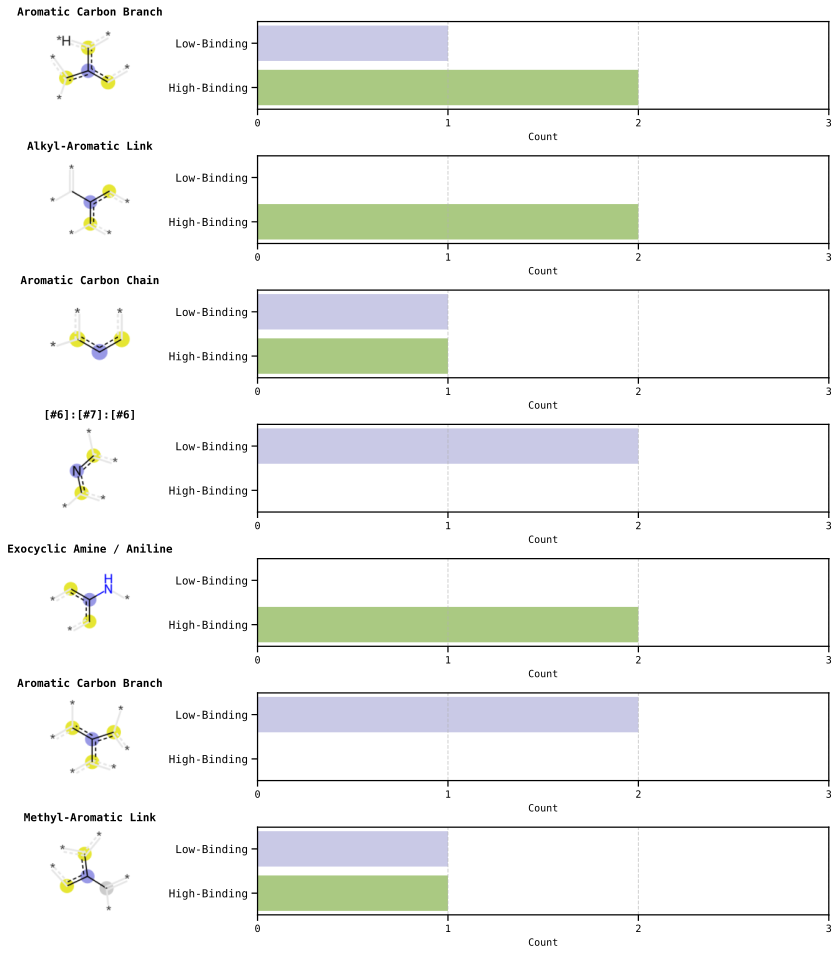

In [21]:
import matplotlib.pyplot as plt
from rdkit.Chem import Draw

# --- Create the comparative plot ---
fig, axes = plt.subplots(len(df_subs_posradius), 2, figsize=(12, 2 * len(df_subs_posradius)), 
                         gridspec_kw={'width_ratios': [1, 3]})

def format_fallback_label(text):
    """
    If a SMARTS string isn't in the legend, try to make it look 
    slightly better than raw code (e.g. remove brackets).
    """
    clean = text.replace("[", "").replace("]", "")
    if len(clean) < 5:
        return clean.upper() 
    return text

# fig.suptitle(f"Top Important Substructure Frequencies for {target_protein_name}", fontsize=16)

for i, (sub_id, row) in enumerate(df_subs_posradius.iterrows()):
    # 1. Draw substructure on the left axis
    ax_img = axes[i, 0]
    repo = high_repo if sub_id in high_repo else low_repo
    mol, bit_info = repo[sub_id]
    
    # RDKit draws the fragment visually here
    env = Draw.DrawMorganBit(mol, sub_id, bit_info)
    ax_img.imshow(env)
    ax_img.axis('off')
    
    raw_smarts = row['sub_name']
    
    # Logic: Try Dictionary -> Fallback to formatting -> Use Raw
    if raw_smarts in smarts_legend:
        clean_label = smarts_legend[raw_smarts]
    else:
        clean_label = format_fallback_label(raw_smarts)
    
    ax_img.set_title(f"{clean_label}", fontsize=11, fontweight='bold')

    # 2. Draw bar chart on the right axis
    ax_bar = axes[i, 1]
    counts = {'High-Binding': row['High-Binding'], 'Low-Binding': row['Low-Binding']}
    
    ax_bar.barh(list(counts.keys()), list(counts.values()), 
                color=DATASET_COLORS[:2] if 'DATASET_COLORS' in locals() else ['crimson', 'royalblue'],
                alpha=0.8)
    
    ax_bar.grid(True, axis='x', linestyle='--', alpha=0.6)
    
    # Dynamic X-axis scaling
    max_bar_value = df_subs_posradius[['High-Binding', 'Low-Binding']].max().max()
    ax_bar.set_xticks(range(0, int(max_bar_value) + 2))
    
    ax_bar.tick_params(axis='x', labelsize=10)
    ax_bar.set_xlabel("Count", fontsize=10)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig(os.path.join(OUTPUT_DIR, target_protein_name, "top_substructure_comparison_non-zero-radius.svg"))
plt.show()

In [38]:
from rdkit import Chem

def get_raw_smarts(mol, bit_info, bit_id):
    """Reconstruct raw SMARTS from bit info for verification."""
    if bit_id not in bit_info: return "Unknown"
    atom_idx, radius = bit_info[bit_id][0]
    if radius == 0:
        return mol.GetAtomWithIdx(atom_idx).GetSmarts()
    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_idx)
    submol = Chem.PathToSubmol(mol, env)
    return Chem.MolToSmarts(submol)

print(f"{'ID':<15} | {'High':<5} | {'Low':<5} | {'Raw SMARTS'}")
print("-" * 65)

for sub_id, row in df_subs_posradius.iterrows():
    # Get the molecule and info to reconstruct the name
    repo = high_repo if sub_id in high_repo else low_repo
    mol, bit_info = repo[sub_id]
    
    # Get the raw SMARTS string
    raw_smarts = get_raw_smarts(mol, bit_info, sub_id)
    
    # Print the data row
    print(f"{sub_id:<15} | {int(row['High-Binding']):<5} | {int(row['Low-Binding']):<5} | {raw_smarts}")

ID              | High  | Low   | Raw SMARTS
-----------------------------------------------------------------
951226070       | 2     | 2     | [#6]:[#6]:[#6]
694069322       | 3     | 0     | [#7]:[#7H]:[#6]
1842898132      | 3     | 0     | [#6]:[#6](:[#6])-[#6]
2353112200      | 1     | 1     | [#6]:[#6](-[#6]):[#6]
2720313463      | 2     | 0     | [#7H]:[#6](:[#6]):[#6]
994485099       | 2     | 0     | [#6]:[#6]:[#6]
1790668568      | 2     | 0     | [#6]-[#7]-[#6]


 ## 12. Advanced Interaction Analysis: What Interacts with What?

 We now dive deeper into the single best and worst binding drugs. We use the
 `InteractionExplainer` to get an atom-to-residue interaction map, answering:
 "Which parts of the drug interact with which specific amino acids?"

Improved visualization with no text overlap:

In [39]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import ConnectionPatch, Rectangle
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit import Chem
from rdkit.Chem import rdDepictor
from IPython.display import display
from io import BytesIO

# --- HELPER: Prevent Label Overlap ---
def spread_labels(indexes, min_dist=2.0):
    """
    Adjusts Y-positions to prevent labels from overlapping.
    Returns a dict: {original_index: new_plot_position}
    """
    if not indexes:
        return {}
    
    # Sort indexes to process them in order
    sorted_idxs = sorted(indexes)
    spread_pos = []
    
    # Place the first label
    current_y = sorted_idxs[0]
    spread_pos.append(current_y)
    
    # Place subsequent labels, pushing them up if they are too close
    for i in range(1, len(sorted_idxs)):
        y = sorted_idxs[i]
        if y - current_y < min_dist:
            current_y = current_y + min_dist
        else:
            current_y = y
        spread_pos.append(current_y)
        
    return dict(zip(sorted_idxs, spread_pos))

def analyze_and_visualize_interaction(ligand_row, protein_seq, title_prefix, protein_name):
    """Generates a polished interaction diagram with corrected sequence lengths and labels."""
    smiles = ligand_row['smiles']
    
    # 1. Prepare Data
    # Note: dataset and device are assumed to be global variables
    data, (_, mol) = dataset.transform_unique(smiles, protein_seq)
    data = data.to(device)
    if not mol: return

    cleanup_model_state(model)
    interaction_explainer = InteractionExplainer(model, device=device)
    interaction_results = interaction_explainer.gradient_atom_residue_map(data, data.target)
    top_interactions_df = interaction_explainer.get_top_interactions(
        interaction_results['interaction_matrix'], data.target, mol, top_k=5)

    # 2. Prepare Molecule Image
    interacting_atoms = list(top_interactions_df['atom_idx'].astype(int))
    rdDepictor.Compute2DCoords(mol)
    
    drawer = rdMolDraw2D.MolDraw2DCairo(500, 500)
    drawer.drawOptions().addAtomIndices = True
    drawer.drawOptions().setHighlightColour((0.9, 0.1, 0.1, 0.7))
    drawer.DrawMolecule(mol, highlightAtoms=interacting_atoms)
    drawer.FinishDrawing()
    
    atom_drawing_coords = {i: drawer.GetDrawCoords(i) for i in range(mol.GetNumAtoms())}
    mol_image = plt.imread(BytesIO(drawer.GetDrawingText()))

    # 3. Prepare Protein Data (FIX: Trim Padding and Use Actual Letters)
    # Slice scores to the actual protein length to remove padding
    seq_len = len(protein_seq)
    protein_attention_scores = interaction_results['residue_attributions'][:seq_len]
    
    # Map residue indices to ACTUAL letters from the sequence string
    interacting_residues_map = {}
    for _, row in top_interactions_df.iterrows():
        r_idx = int(row['residue_idx'])
        # Ensure we don't index out of bounds
        if r_idx < seq_len:
            interacting_residues_map[r_idx] = protein_seq[r_idx]

    # 4. Create Figure Layout
    fig = plt.figure(figsize=(16, 8))
    #fig.suptitle(f'{title_prefix}\nSMILES: {smiles[:60]}...', fontsize=14, fontfamily='monospace')
    
    ax_mol = fig.add_axes([0.05, 0.1, 0.5, 0.8])
    ax_prot = fig.add_axes([0.60, 0.1, 0.1, 0.8])

    # 5. Plot Molecule
    ax_mol.imshow(mol_image)
    ax_mol.set_title("Drug Molecule", fontsize=12)
    ax_mol.axis('off')

    # 6. Plot Protein Bar (Corrected Extent)
    # origin='lower' ensures index 0 is at the bottom. 
    # extent sets the Y-axis to match the actual sequence length.
    protein_display = np.expand_dims(protein_attention_scores, axis=1)
    ax_prot.imshow(protein_display, cmap='Blues', aspect='auto', origin='lower', 
                   extent=[-0.5, 0.5, 0, seq_len])
    
    ax_prot.set_title("Protein\nImportance", fontsize=12)
    ax_prot.set_ylabel("Residue Index")
    ax_prot.set_xticks([])
    
    # 7. Draw Highlights and Labels
    # Calculate spread positions to avoid text overlap
    # min_dist is calculated relative to protein length to keep labels readable
    label_positions = spread_labels(list(interacting_residues_map.keys()), min_dist=seq_len * 0.04)

    for res_idx, res_char in interacting_residues_map.items():
        # Draw box on the heatmap around the specific residue
        rect = Rectangle((-0.5, res_idx - 0.5), 1, 1, fill=False, edgecolor='crimson', lw=2)
        ax_prot.add_patch(rect)
        
        # Draw Label with Arrow
        # xy is the point on the bar, xytext is where the text sits
        y_pos_text = label_positions[res_idx]
        
        ax_prot.annotate(
            text=f"{res_char}{res_idx}", # Uses actual letter e.g. "C117"
            xy=(0.5, res_idx),
            xytext=(1.5, y_pos_text),
            xycoords='data',
            textcoords='data',
            ha='left', va='center',
            color='crimson',
            fontweight='bold',
            fontfamily='monospace',
            fontsize=11,
            arrowprops=dict(arrowstyle="-", color='crimson', alpha=0.5)
        )

    # 8. Draw Connections between Molecule and Protein
    for _, interaction in top_interactions_df.iterrows():
        atom_idx, res_idx = int(interaction['atom_idx']), int(interaction['residue_idx'])
        
        # Only draw if valid
        if res_idx < seq_len:
            pos = atom_drawing_coords[atom_idx]
            start_point = (pos.x, pos.y)
            end_point = (-0.5, res_idx) # Left edge of protein bar at residue height

            con = ConnectionPatch(xyA=start_point, xyB=end_point, coordsA="data", coordsB="data",
                                  axesA=ax_mol, axesB=ax_prot, color='darkgreen',
                                  arrowstyle="->", mutation_scale=20, lw=2, alpha=0.6, zorder=10)
            fig.add_artist(con)

    # Save and Display
    filename = f"interaction_{title_prefix.lower().replace(' ', '_').replace('#','')}.svg"
    save_path = os.path.join(OUTPUT_DIR, protein_name, filename)
    plt.savefig(save_path, bbox_inches='tight')
    plt.close(fig)
    
    print(f"Generated: {title_prefix}")
    display(fig)
    
    # Display table with Actual Amino Acid letter for verification
    display_df = top_interactions_df[['residue_idx', 'atom_symbol', 'atom_idx', 'interaction_score']].copy()
    # Insert the looked-up amino acid letter into the dataframe
    display_df.insert(0, 'AA', [protein_seq[int(i)] if int(i) < len(protein_seq) else '?' for i in display_df['residue_idx']])
    display(display_df.style.background_gradient(cmap='viridis'))
    print("-" * 80)



In [ ]:

# --- MAIN EXECUTION LOOP ---

if 'top_k_ligands' in locals() and 'bottom_k_ligands' in locals():
    protein_sequence_full = protein_seq 
    
    # Loop through ALL top binders
    print("\n=== ANALYZING TOP BINDERS ===")
    for i, (idx, row) in enumerate(top_k_ligands.iterrows()):
        title = f"Top Binder #{i+1} (ID: {idx})"
        analyze_and_visualize_interaction(row, protein_sequence_full, title, target_protein_name)

    # Loop through ALL bottom binders
    print("\n=== ANALYZING BOTTOM BINDERS ===")
    for i, (idx, row) in enumerate(bottom_k_ligands.iterrows()):
        title = f"Weak Binder #{i+1} (ID: {idx})"
        analyze_and_visualize_interaction(row, protein_sequence_full, title, target_protein_name)

## 13. On-Demand Analysis for a Custom Pair

--- Running On-Demand Analysis ---
Protein Sequence (first 40 chars): MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTV...
SMILES String: CC(C)(C(N)=O)n1cc(-c2cnc(N)c3c(-c4ccc(NC(=O)Nc5cccc(F)c5)cc4)csc23)cn1
Saving output to: notebooks/results/batch_attention_analysis/Protein_4
2025-11-25 12:32:17.425 | DEBUG    | xai.interaction_explainer:gradient_atom_residue_map:133 - protein_embed shape: torch.Size([1, 1200, 128])
2025-11-25 12:32:17.425 | DEBUG    | xai.interaction_explainer:gradient_atom_residue_map:134 - original_node_features shape: torch.Size([38, 22])
2025-11-25 12:32:17.425 | DEBUG    | xai.interaction_explainer:gradient_atom_residue_map:161 - residue_attributions shape: (1200,)
2025-11-25 12:32:17.426 | DEBUG    | xai.interaction_explainer:gradient_atom_residue_map:162 - atom_attributions shape: (38,)
2025-11-25 12:32:17.426 | DEBUG    | xai.interaction_explainer:gradient_atom_residue_map:163 - interaction matrix shape: (1200, 38)
Generated: 


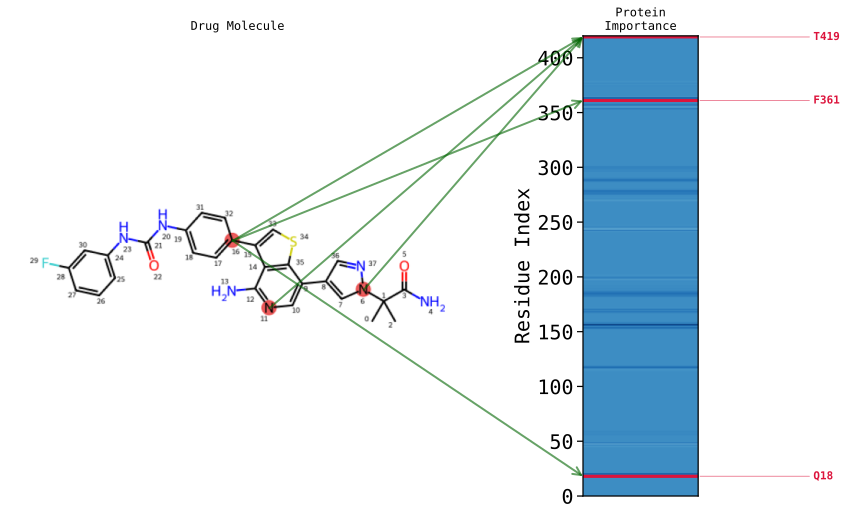

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,T,419,C,16,0.003122
1,Q,18,C,16,-0.001729
2,T,419,N,6,0.001708
3,F,361,C,16,-0.001602
4,T,419,N,11,0.001566


--------------------------------------------------------------------------------


In [33]:

# This cell allows to run the detailed interaction analysis for any
# arbitrary protein sequence and SMILES string.

# --- 1. Define Inputs ---
if 'top_k_ligands' in locals() and not top_k_ligands.empty:
    
    custom_protein_seq = 'MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST'
    custom_smiles = 'CC(C)(C(N)=O)n1cc(-c2cnc(N)c3c(-c4ccc(NC(=O)Nc5cccc(F)c5)cc4)csc23)cn1'
    
    print("--- Running On-Demand Analysis ---")
    print(f"Protein Sequence (first 40 chars): {custom_protein_seq[:40]}...")
    print(f"SMILES String: {custom_smiles}")

    # --- 2. Prepare Inputs for the Function ---
    # The function `analyze_and_visualize_interaction` expects a dictionary-like object for the ligand.
    custom_ligand_row = {'smiles': custom_smiles}
    
    
    # Create the output directory if it doesn't exist
    output_path = os.path.join(OUTPUT_DIR, PROTEIN_NAME)
    os.makedirs(output_path, exist_ok=True)
    print(f"Saving output to: {output_path}")

    # --- 3. Run the Visualization ---
    analyze_and_visualize_interaction(
        ligand_row=custom_ligand_row,
        protein_seq=custom_protein_seq,
        title_prefix="",
        protein_name=PROTEIN_NAME
    )
else:
    print("Could not find 'top_k_ligands'. Please run the preceding cells to select a target protein and its ligands first.")







## 14. Advanced Interaction Analysis with Integrated Gradients

**Integrated Gradients (IG) provides more robust explanations than simple gradients** => this section duplicates the final analysis using the `integrated_gradients_interaction` method. While more computationally intensive, the resulting attributions are theoretically more sound as they address potential gradient saturation issues.

First, we define a new visualization function that is nearly identical to the previous one, but calls the IG method from our `InteractionExplainer`.



In [40]:

# In[ ]:


def analyze_and_visualize_interaction_ig(ligand_row, protein_seq, title_prefix, protein_name, n_steps=50):
    """
    Generates a polished interaction diagram using Integrated Gradients.
    This is a more robust, but slower, version of the analysis.
    """
    smiles = ligand_row['smiles']

    # 1. Prepare Data
    data, (_, mol) = dataset.transform_unique(smiles, protein_seq)
    data = data.to(device)
    if not mol: return

    cleanup_model_state(model)
    interaction_explainer = InteractionExplainer(model, device=device)
    
    # --- Use Integrated Gradients ---
    print(f"Computing Integrated Gradients for '{title_prefix}' with {n_steps} steps... (This may take a moment)")
    interaction_results = interaction_explainer.integrated_gradients_interaction(data, data.target, n_steps=n_steps)
    
    top_interactions_df = interaction_explainer.get_top_interactions(
        interaction_results['interaction_matrix'], data.target, mol, top_k=5)

    # 2a. Prepare High-Quality SVG of the Molecule
    interacting_atoms = list(top_interactions_df['atom_idx'].astype(int))
    rdDepictor.Compute2DCoords(mol)
    svg_drawer = rdMolDraw2D.MolDraw2DSVG(500, 500)
    svg_drawer.drawOptions().addAtomIndices = True
    svg_drawer.drawOptions().setHighlightColour((0.9, 0.1, 0.1, 0.7))
    svg_drawer.DrawMolecule(mol, highlightAtoms=interacting_atoms)
    svg_drawer.FinishDrawing()
    mol_svg_content = svg_drawer.GetDrawingText()

    # Save the standalone SVG file
    svg_filename = f"molecule_ig_{title_prefix.lower().replace(' ', '_').replace('#','')}.svg"
    svg_save_path = os.path.join(OUTPUT_DIR, protein_name, svg_filename)
    with open(svg_save_path, 'w') as f:
        f.write(mol_svg_content)
    
    # 2b. Prepare Molecule Image for Matplotlib plot
    drawer = rdMolDraw2D.MolDraw2DCairo(500, 500)
    drawer.drawOptions().addAtomIndices = True
    drawer.drawOptions().setHighlightColour((0.9, 0.1, 0.1, 0.7))
    drawer.DrawMolecule(mol, highlightAtoms=interacting_atoms)
    drawer.FinishDrawing()
    atom_drawing_coords = {i: drawer.GetDrawCoords(i) for i in range(mol.GetNumAtoms())}
    mol_image = plt.imread(BytesIO(drawer.GetDrawingText()))

    # 3. Prepare Protein Data
    seq_len = len(protein_seq)
    protein_attention_scores = interaction_results['residue_attributions'][:seq_len]
    interacting_residues_map = {int(row['residue_idx']): protein_seq[int(row['residue_idx'])] for _, row in top_interactions_df.iterrows() if int(row['residue_idx']) < seq_len}

    # 4. Create Figure Layout
    fig = plt.figure(figsize=(16, 8))
    #fig.suptitle(f'{title_prefix} (Integrated Gradients)\nSMILES: {smiles[:60]}...', fontsize=14, fontfamily='monospace')

    ax_mol = fig.add_axes([0.05, 0.1, 0.5, 0.8])
    ax_prot = fig.add_axes([0.60, 0.1, 0.05, 0.8])

    # 5. Plot Molecule
    ax_mol.imshow(mol_image)
    ax_mol.set_title("Drug Molecule", fontsize=12)
    ax_mol.axis('off')

    # 6. Plot Protein Bar
    protein_display = np.expand_dims(protein_attention_scores, axis=1)
    ax_prot.imshow(protein_display, cmap='Blues', aspect='auto', origin='lower', extent=[-0.5, 0.5, 0, seq_len])
    ax_prot.set_title("Protein Importance (IG)", fontsize=12)
    ax_prot.set_ylabel("Residue Index")
    ax_prot.set_xticks([])

    # 7. Draw Highlights and Labels
    label_positions = spread_labels(list(interacting_residues_map.keys()), min_dist=seq_len * 0.04)
    for res_idx, res_char in interacting_residues_map.items():
        rect = Rectangle((-0.5, res_idx - 0.5), 1, 1, fill=False, edgecolor='crimson', lw=2)
        ax_prot.add_patch(rect)
        y_pos_text = label_positions[res_idx]
        ax_prot.annotate(
            text=f"{res_char}{res_idx}",
            xy=(0.5, res_idx), xytext=(1, y_pos_text),
            xycoords='data', textcoords='data',
            ha='left', va='center', color='crimson', fontweight='bold', fontfamily='monospace', fontsize=11,
            arrowprops=dict(arrowstyle="-", color='crimson', alpha=0.5)
        )

    # 8. Draw Connections
    for _, interaction in top_interactions_df.iterrows():
        atom_idx, res_idx = int(interaction['atom_idx']), int(interaction['residue_idx'])
        if res_idx < seq_len:
            pos = atom_drawing_coords[atom_idx]
            start_point = (pos.x, pos.y)
            end_point = (-0.5, res_idx)
            con = ConnectionPatch(xyA=start_point, xyB=end_point, coordsA="data", coordsB="data",
                                  axesA=ax_mol, axesB=ax_prot, color='darkgreen',
                                  arrowstyle="->", mutation_scale=20, lw=2, alpha=0.7, zorder=10)
            fig.add_artist(con)

    # Save and Display
    filename = f"interaction_ig_{title_prefix.lower().replace(' ', '_').replace('#','')}.svg"
    save_path = os.path.join(OUTPUT_DIR, protein_name, filename)
    plt.savefig(save_path, bbox_inches='tight')
    plt.close(fig)

    print(f"Generated (IG): {title_prefix}")
    display(fig)

    display_df = top_interactions_df[['residue_idx', 'atom_symbol', 'atom_idx', 'interaction_score']].copy()
    display_df.insert(0, 'AA', [protein_seq[int(i)] if int(i) < len(protein_seq) else '?' for i in display_df['residue_idx']])
    display(display_df.style.background_gradient(cmap='viridis'))
    print("-" * 80)




=== ANALYZING TOP BINDERS (INTEGRATED GRADIENTS) ===
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
O=C1NC(=O)C(c2cnc3ccccn23)=C1c1cn2c3c(cccc13)CN(C(=O)N1CCOCC1)CC2
Computing Integrated Gradients for 'Top Binder #1 (ID: 0)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #1 (ID: 0)


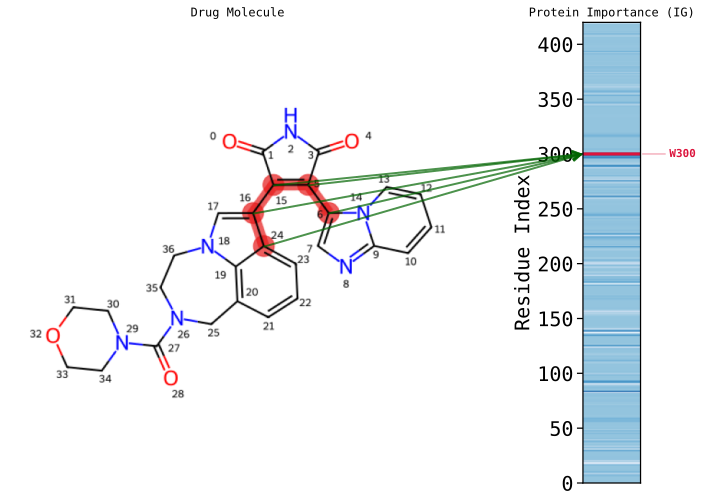

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,W,300,C,16,0.189527
1,W,300,C,5,0.186943
2,W,300,C,15,-0.166596
3,W,300,C,6,-0.148368
4,W,300,C,24,-0.139872


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
COc1ccc(Cn2ncc(NC(=O)c3cc(NC(=O)Nc4ccc(Cl)c(C(F)(F)F)c4)ccc3C)c2N)cc1
Computing Integrated Gradients for 'Top Binder #2 (ID: 1)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #2 (ID: 1)


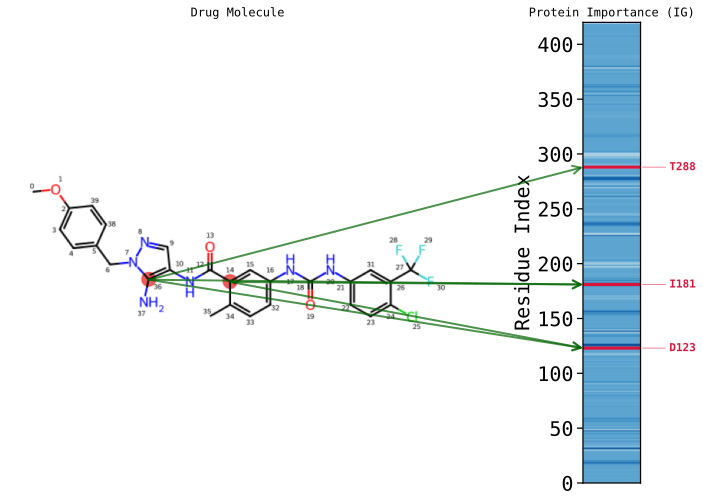

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,D,123,C,36,-0.140306
1,D,123,C,14,-0.139873
2,I,181,C,36,0.118265
3,I,181,C,14,0.117899
4,T,288,C,36,-0.104280


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
CC(C)OC(=O)N1CCn2cc(C3=C(c4cnc5ccccn45)C(=O)NC3=O)c3cccc(c32)C1
Computing Integrated Gradients for 'Top Binder #3 (ID: 2)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #3 (ID: 2)


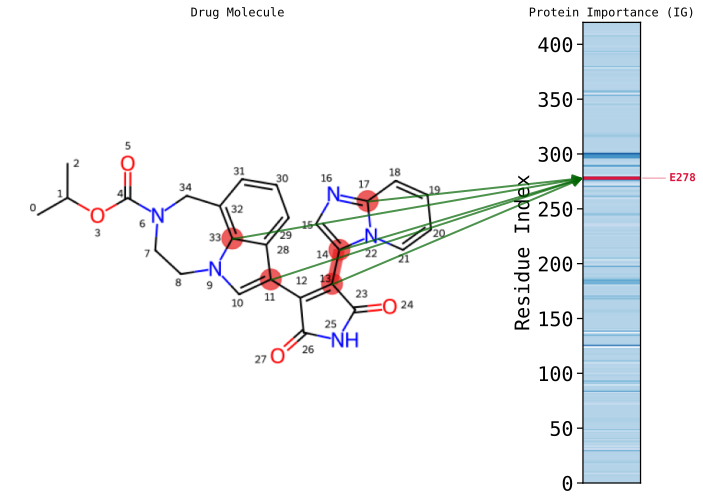

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,E,278,C,13,0.067231
1,E,278,C,11,0.066487
2,E,278,C,14,-0.063426
3,E,278,C,33,0.061347
4,E,278,C,17,-0.056828


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
O=C(O)c1ccccc1Nc1ccnc(Nc2cccc(F)c2)n1
Computing Integrated Gradients for 'Top Binder #4 (ID: 3)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #4 (ID: 3)


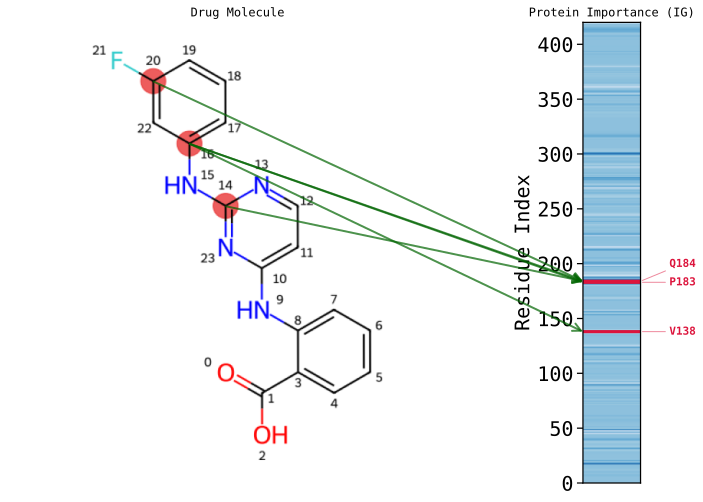

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,Q,184,C,16,0.162593
1,V,138,C,16,0.143749
2,Q,184,C,20,0.133231
3,Q,184,C,14,0.126519
4,P,183,C,16,0.124518


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
O=C1Nc2ccccc2C1=Cc1cn[nH]c1-c1ccccc1[N+](=O)[O-]
Computing Integrated Gradients for 'Top Binder #5 (ID: 4)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #5 (ID: 4)


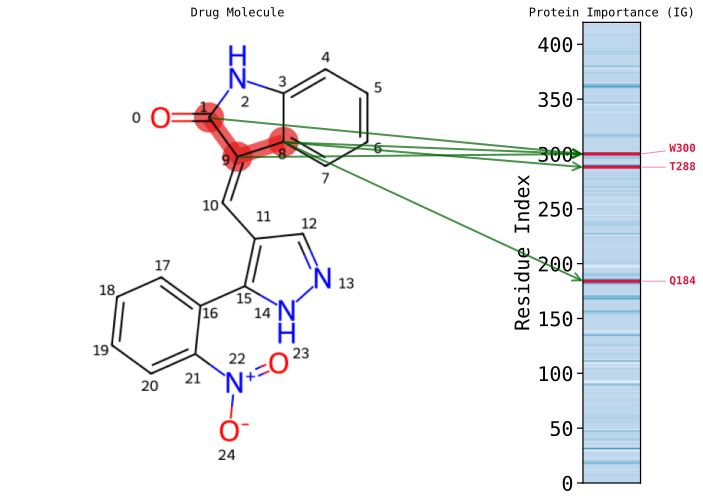

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,W,300,C,8,0.158554
1,W,300,C,1,0.119940
2,W,300,C,9,-0.113206
3,T,288,C,8,0.104507
4,Q,184,C,8,0.099210


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
CCN1CCN(CCCC(=O)Nc2n[nH]c3nnc(-c4cccc(F)c4F)cc23)CC1
Computing Integrated Gradients for 'Top Binder #6 (ID: 5)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #6 (ID: 5)


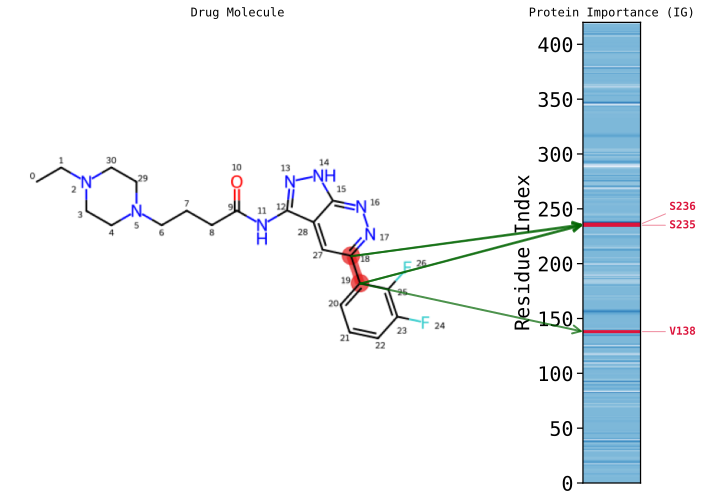

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,S,236,C,19,0.132185
1,S,236,C,18,-0.124264
2,S,235,C,19,0.117611
3,S,235,C,18,-0.110564
4,V,138,C,19,-0.110373


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Nc1n[nH]c2ccc(-c3nnn(Cc4ccccc4)c3-c3ccc(F)cc3)cc12
Computing Integrated Gradients for 'Top Binder #7 (ID: 6)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #7 (ID: 6)


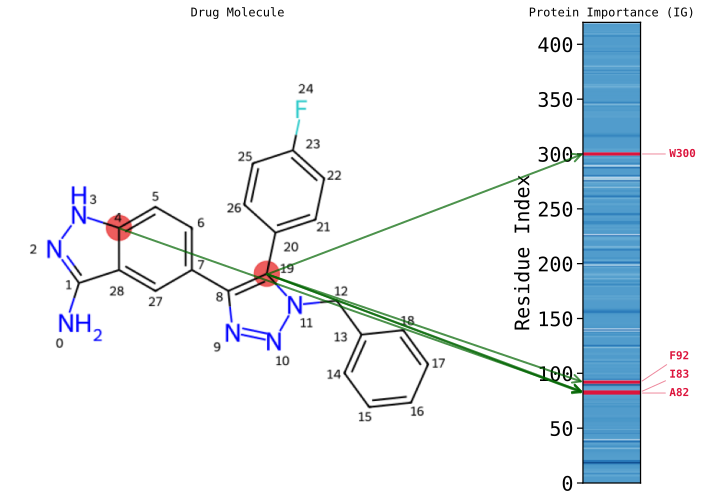

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,I,83,C,19,-0.130599
1,W,300,C,19,-0.128295
2,F,92,C,19,-0.114860
3,A,82,C,19,0.095915
4,I,83,C,4,-0.093630


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
COc1ccc(CNc2cc(-c3c[nH]c4ncccc34)cc(F)n2)cc1
Computing Integrated Gradients for 'Top Binder #8 (ID: 7)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #8 (ID: 7)


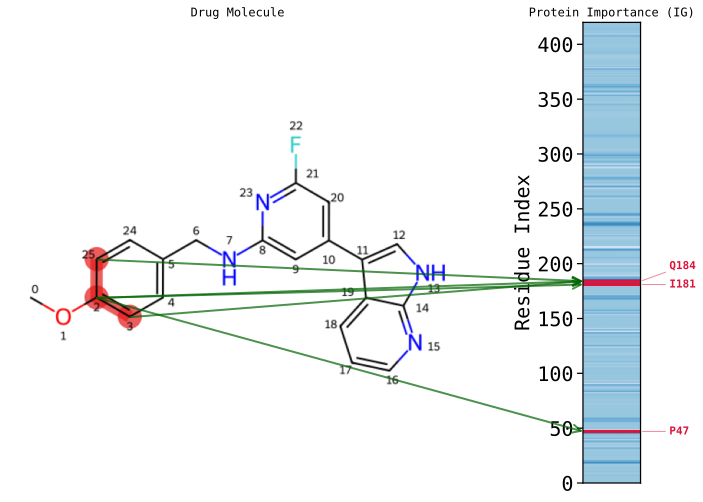

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,Q,184,C,2,-0.163888
1,Q,184,C,25,0.119442
2,Q,184,C,3,0.119442
3,I,181,C,2,-0.114533
4,P,47,C,2,-0.106356


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
CN(c1ncccc1CNc1nc(Nc2ccc3c(c2)CC(=O)N3)ncc1C(F)(F)F)S(C)(=O)=O
Computing Integrated Gradients for 'Top Binder #9 (ID: 8)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #9 (ID: 8)


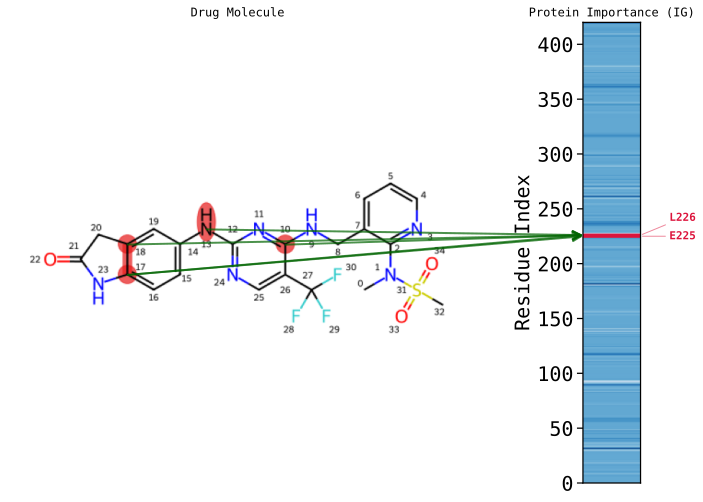

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,L,226,C,17,-0.035212
1,E,225,C,17,0.031701
2,L,226,N,13,-0.031541
3,L,226,C,18,0.030582
4,L,226,C,10,-0.030432


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Nc1n[nH]c2ccc(-c3nnn(Cc4ccccc4)c3C3CC3)cc12
Computing Integrated Gradients for 'Top Binder #10 (ID: 9)' with 50 steps... (This may take a moment)
Generated (IG): Top Binder #10 (ID: 9)


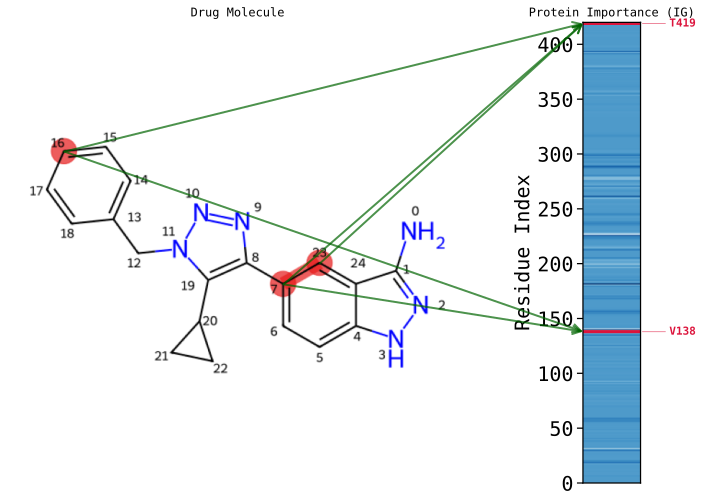

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,T,419,C,7,-0.174476
1,V,138,C,7,-0.168083
2,T,419,C,16,-0.142417
3,V,138,C,16,-0.137198
4,T,419,C,23,0.133911


--------------------------------------------------------------------------------

=== ANALYZING BOTTOM BINDERS (INTEGRATED GRADIENTS) ===
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
COCCC(C(N)=O)N(C)Cc1cc2c(Nc3cccc(Cl)c3F)ncnc2cc1OC
Computing Integrated Gradients for 'Weak Binder #1 (ID: 200)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #1 (ID: 200)


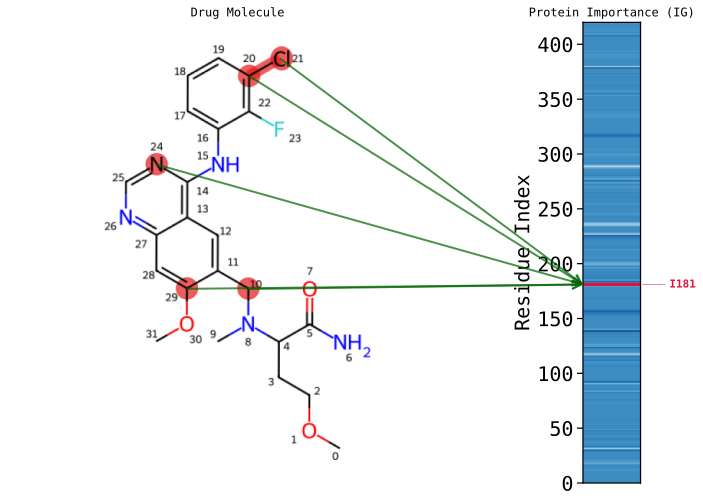

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,I,181,Cl,21,0.031227
1,I,181,C,20,-0.027606
2,I,181,C,10,0.023561
3,I,181,N,24,0.022319
4,I,181,C,29,0.021036


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
CCNc1nnc2ccc(-c3ocnc3-c3ccc(F)cc3)cn12
Computing Integrated Gradients for 'Weak Binder #2 (ID: 201)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #2 (ID: 201)


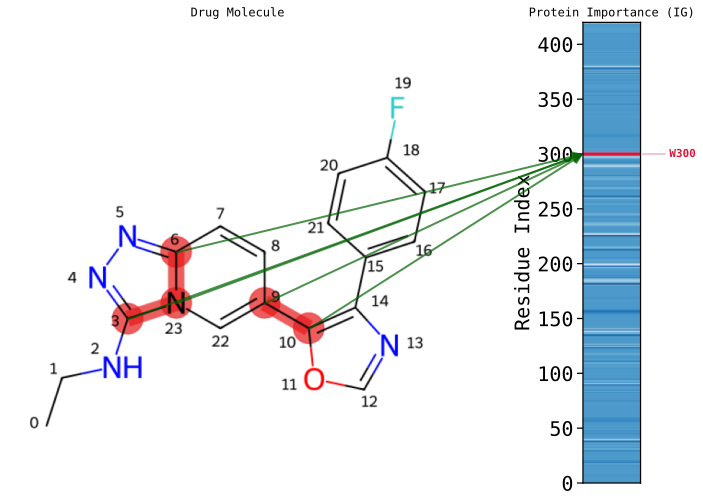

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,W,300,C,6,-0.419094
1,W,300,C,10,-0.414440
2,W,300,N,23,0.390790
3,W,300,C,3,-0.371765
4,W,300,C,9,0.345895


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
COc1cc2ncnc(Nc3cccc(Cl)c3F)c2cc1CN(C)C1(C(N)=O)CN(C(C)C)C1
Computing Integrated Gradients for 'Weak Binder #3 (ID: 202)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #3 (ID: 202)


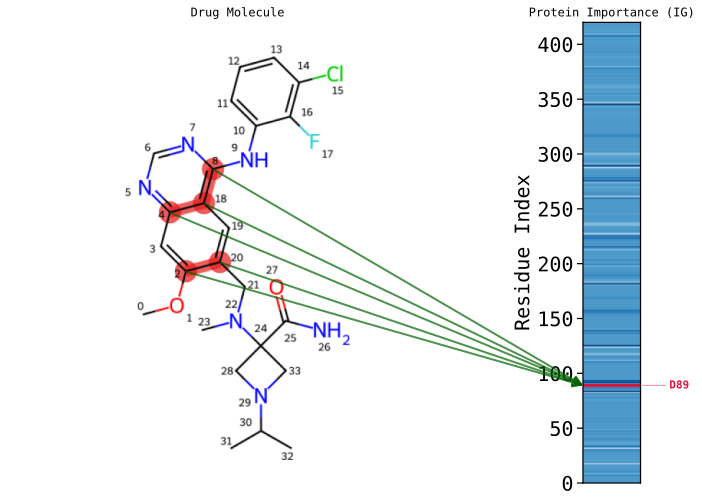

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,D,89,C,4,0.151369
1,D,89,C,8,0.148915
2,D,89,C,18,-0.144046
3,D,89,C,2,0.127669
4,D,89,C,20,-0.124149


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Cc1cccc(-c2[nH]ncc2-c2ccc3ncccc3n2)n1
Computing Integrated Gradients for 'Weak Binder #4 (ID: 203)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #4 (ID: 203)


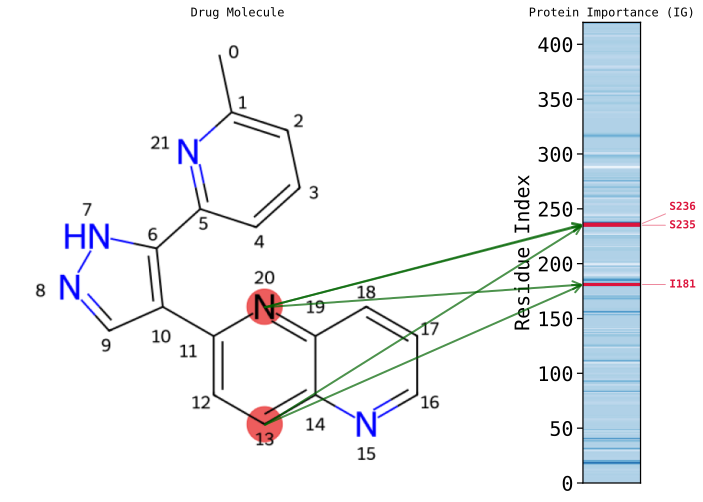

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,S,235,N,20,0.203816
1,I,181,N,20,0.196382
2,S,235,C,13,-0.192827
3,S,236,N,20,0.192479
4,I,181,C,13,-0.185793


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
COc1ccccc1CNc1ncc(C(=O)NC2CCN(C)CC2)c(NC2CCCC2)n1
Computing Integrated Gradients for 'Weak Binder #5 (ID: 204)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #5 (ID: 204)


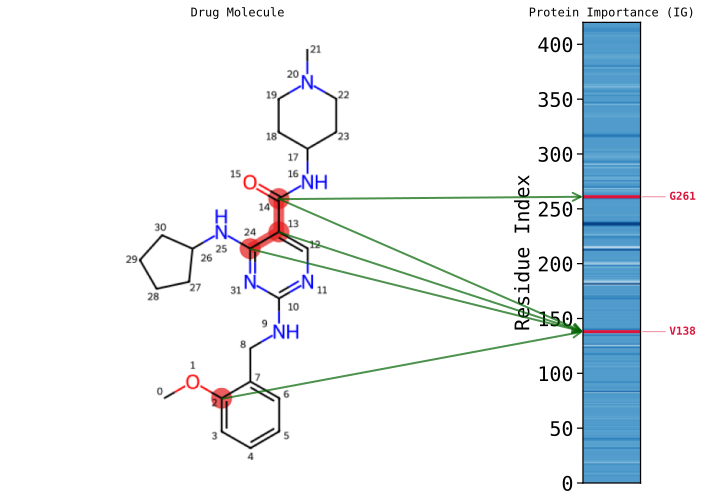

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,V,138,C,14,-0.369077
1,V,138,C,24,-0.351511
2,V,138,C,2,0.318269
3,V,138,C,13,0.304857
4,G,261,C,14,-0.302820


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
CSc1ccccc1Nc1nc(N2CCNCC2)nc2c(NCC3CC3)ncnc12
Computing Integrated Gradients for 'Weak Binder #6 (ID: 205)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #6 (ID: 205)


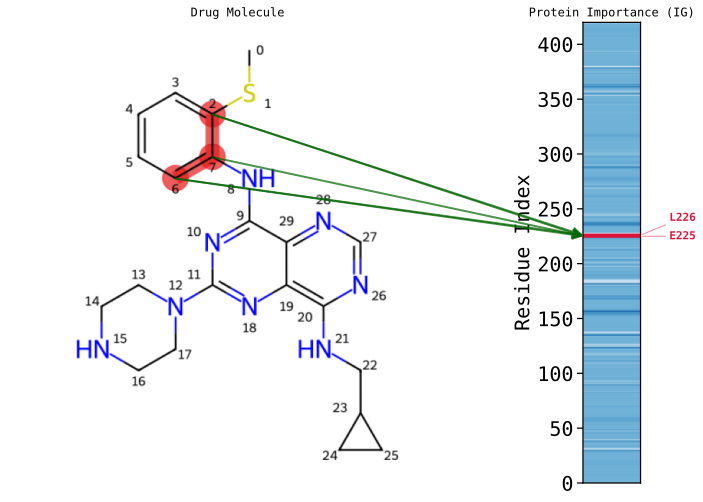

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,E,225,C,2,-0.156061
1,L,226,C,2,0.148717
2,E,225,C,6,-0.143384
3,E,225,C,7,0.141163
4,L,226,C,6,0.136636


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Cc1cccc(-c2cccc3onc(N)c23)c1
Computing Integrated Gradients for 'Weak Binder #7 (ID: 206)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #7 (ID: 206)


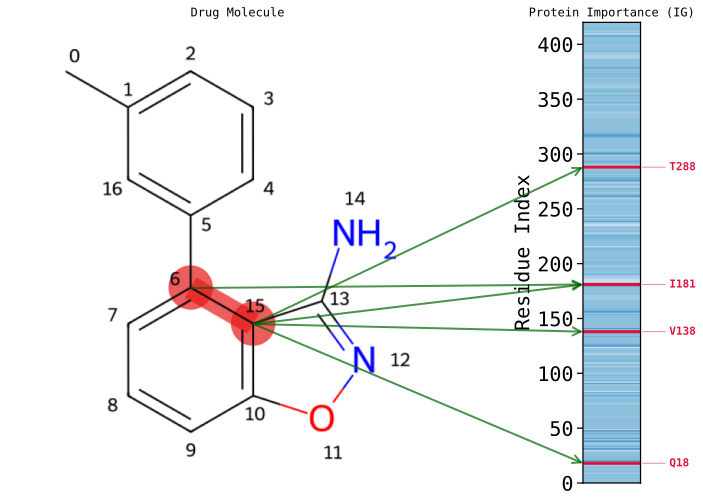

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,I,181,C,15,-0.087338
1,I,181,C,6,0.072208
2,Q,18,C,15,-0.070990
3,T,288,C,15,0.062608
4,V,138,C,15,-0.059245


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Cn1cnc(CNc2cc(Br)c3ncc(C#N)c(Nc4ccc(F)c(Cl)c4)c3c2)c1
Computing Integrated Gradients for 'Weak Binder #8 (ID: 207)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #8 (ID: 207)


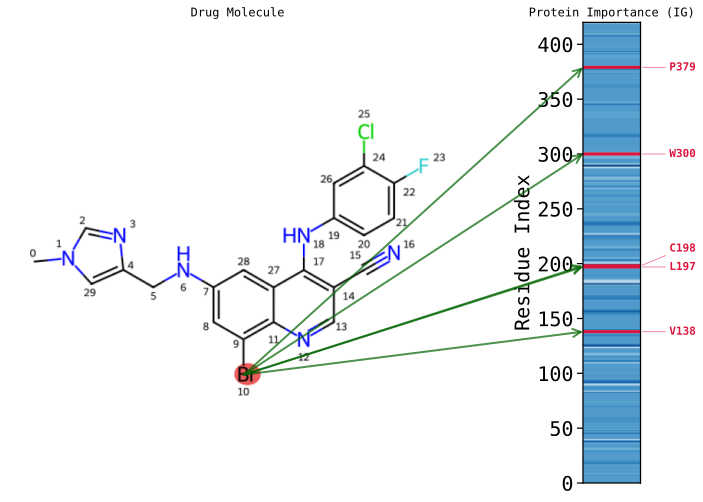

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,L,197,Br,10,0.063337
1,W,300,Br,10,0.052414
2,P,379,Br,10,0.051709
3,V,138,Br,10,0.048058
4,C,198,Br,10,-0.045814


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
Nc1ncnc2scc(-c3ccccc3)c12
Computing Integrated Gradients for 'Weak Binder #9 (ID: 208)' with 50 steps... (This may take a moment)
Generated (IG): Weak Binder #9 (ID: 208)


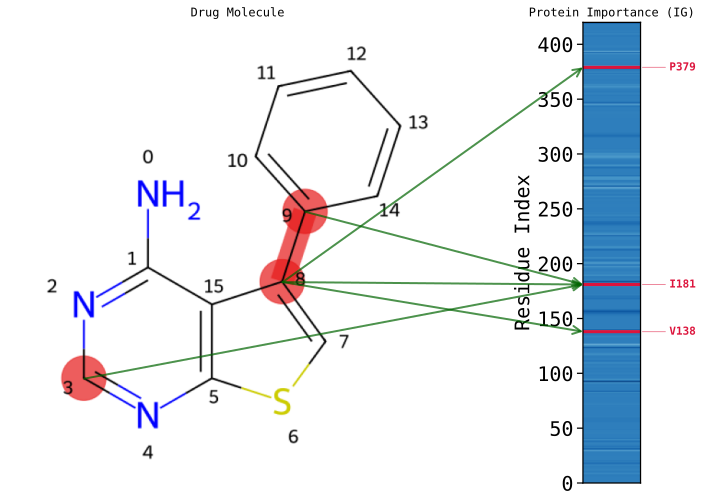

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,I,181,C,8,-0.250641
1,I,181,C,9,0.185588
2,P,379,C,8,-0.152149
3,I,181,C,3,0.149782
4,V,138,C,8,-0.137861


--------------------------------------------------------------------------------
MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST
O=C1NCc2c1cccc2-c1cccs1
Computing Integrated Gradients for 'Weak Binder #10 (ID: 209)' with 50 steps... (This may take a moment)


In [ ]:

# In[ ]:


# --- MAIN EXECUTION LOOP (INTEGRATED GRADIENTS) ---

if 'top_k_ligands' in locals() and 'bottom_k_ligands' in locals():
    protein_sequence_full = protein_seq 

    # Loop through ALL top binders
    print("\n=== ANALYZING TOP BINDERS (INTEGRATED GRADIENTS) ===")
    for i, (idx, row) in enumerate(top_k_ligands.iterrows()):
        title = f"Top Binder #{i+1} (ID: {idx})"
        print(protein_sequence_full)
        print(row['smiles'])
        analyze_and_visualize_interaction_ig(row, protein_sequence_full, title, target_protein_name, n_steps=50)

    # Loop through ALL bottom binders
    print("\n=== ANALYZING BOTTOM BINDERS (INTEGRATED GRADIENTS) ===")
    for i, (idx, row) in enumerate(bottom_k_ligands.iterrows()):
        title = f"Weak Binder #{i+1} (ID: {idx})"
        print(protein_sequence_full)
        print(row['smiles'])
        analyze_and_visualize_interaction_ig(row, protein_sequence_full, title, target_protein_name, n_steps=50)


## 15. On-Demand Analysis for a Custom Pair (Integrated Gradients)

--- Running On-Demand Analysis (Integrated Gradients) ---
Protein Sequence (first 40 chars): MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTV...
SMILES String: CC(C)(C(N)=O)n1cc(-c2cnc(N)c3c(-c4ccc(NC(=O)Nc5cccc(F)c5)cc4)csc23)cn1
Saving output to: notebooks/results/batch_attention_analysis/Protein_4
Computing Integrated Gradients for 'mapping' with 150 steps... (This may take a moment)
Generated (IG): mapping


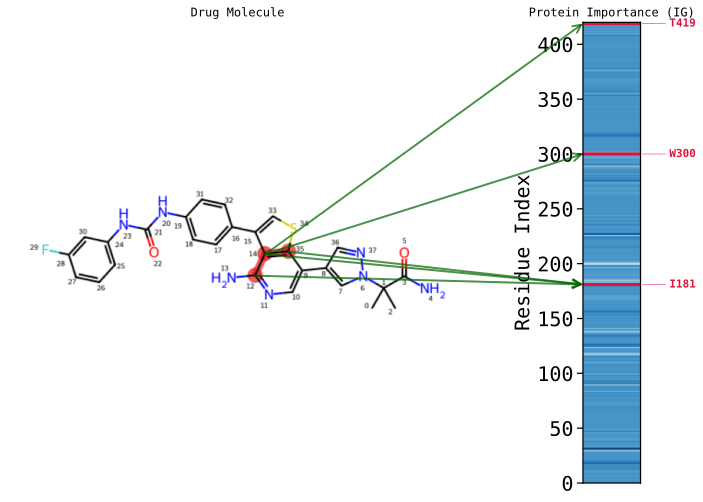

,AA,residue_idx,atom_symbol,atom_idx,interaction_score
0,I,181,C,14,0.019966
1,I,181,C,35,-0.019165
2,W,300,C,14,0.017181
3,T,419,C,14,0.017162
4,I,181,C,12,-0.016797


--------------------------------------------------------------------------------


In [47]:


# This cell allows to run the detailed interaction analysis for any
# arbitrary protein sequence and SMILES string using the more robust IG method.

# --- 1. Define Your Inputs ---
if 'top_k_ligands' in locals() and not top_k_ligands.empty:

    
    custom_protein_seq_ig = 'MSGRPRTTSFAESCKPVQQPSAFGSMKVSRDKDGSKVTTVVATPGQGPDRPQEVSYTDTKVIGNGSFGVVYQAKLCDSGELVAIKKVLQDKRFKNRELQIMRKLDHCNIVRLRYFFYSSGEKKDEVYLNLVLDYVPETVYRVARHYSRAKQTLPVIYVKLYMYQLFRSLAYIHSFGICHRDIKPQNLLLDPDTAVLKLCDFGSAKQLVRGEPNVSYICSRYYRAPELIFGATDYTSSIDVWSAGCVLAELLLGQPIFPGDSGVDQLVEIIKVLGTPTREQIREMNPNYTEFKFPQIKAHPWTKVFRPRTPPEAIALCSRLLEYTPTARLTPLEACAHSFFDELRDPNVKLPNGRDTPALFNFTTQELSSNPPLATILIPPHARIQAAASTPTNATAASDANTGDRGQTNNAASASASNST'
    custom_smiles_ig = 'CC(C)(C(N)=O)n1cc(-c2cnc(N)c3c(-c4ccc(NC(=O)Nc5cccc(F)c5)cc4)csc23)cn1'
    
    print("--- Running On-Demand Analysis (Integrated Gradients) ---")
    print(f"Protein Sequence (first 40 chars): {custom_protein_seq_ig[:40]}...")
    print(f"SMILES String: {custom_smiles_ig}")

    # --- 2. Prepare Inputs for the Function ---
    custom_ligand_row_ig = {'smiles': custom_smiles_ig}

    # Create the output directory if it doesn't exist
    output_path = os.path.join(OUTPUT_DIR, PROTEIN_NAME)
    os.makedirs(output_path, exist_ok=True)
    print(f"Saving output to: {output_path}")

    # --- 3. Run the Visualization ---
    analyze_and_visualize_interaction_ig(
        ligand_row=custom_ligand_row_ig,
        protein_seq=custom_protein_seq_ig,
        title_prefix="mapping",#"On-Demand IG Analysis",
        protein_name=PROTEIN_NAME,
        n_steps=150 # Higher steps for a more refined one-off analysis
    )
else:
    print("Could not find 'top_k_ligands'. Please run the preceding cells to select a target protein and its ligands first.")
